# CNN on RoboND-Rover project dataset

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### **Sample of collected dataset:**

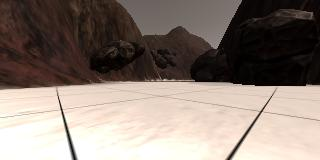

In [2]:
# going to the HW path --> in this folder you should have a folder "data" that cotains your images and the CSV file
%cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
#change \ sign in data to / sign

In [3]:
%matplotlib inline

import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt 
import torch
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
import matplotlib.image as img
import os
from PIL import Image
from torch import nn

from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split

In [4]:
# CPU or GPU

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=0)

# Data preprocessing

In [5]:
train_path = 'data_3000/IMG'
# read the CSV file
df = pd.read_csv("/content/drive/MyDrive/data_3000/robot_log.csv",delimiter=";")
df.head()

,Path,SteerAngle,Throttle,Brake,Speed,X_Position,Y_Position,Pitch,Yaw,Roll
0,robocam_2021_04_04_20_34_50_560.jpg,0.000000,0.0,1.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002
1,robocam_2021_04_04_20_34_50_615.jpg,0.000000,0.0,0.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002
2,robocam_2021_04_04_20_34_50_681.jpg,0.000000,0.0,0.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002
3,robocam_2021_04_04_20_34_50_748.jpg,0.000000,0.0,0.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002
4,robocam_2021_04_04_20_34_50_816.jpg,-2.076846,0.0,0.0,0.0,99.66999,85.58899,0.000237,46.96957,0.000002


In [6]:
df['SteerAngle_normal'] = df['SteerAngle'].apply(lambda x: (x+15)/30) 

In [7]:
df.head()

,Path,SteerAngle,Throttle,Brake,Speed,X_Position,Y_Position,Pitch,Yaw,Roll,SteerAngle_normal
0,robocam_2021_04_04_20_34_50_560.jpg,0.000000,0.0,1.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002,0.500000
1,robocam_2021_04_04_20_34_50_615.jpg,0.000000,0.0,0.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002,0.500000
2,robocam_2021_04_04_20_34_50_681.jpg,0.000000,0.0,0.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002,0.500000
3,robocam_2021_04_04_20_34_50_748.jpg,0.000000,0.0,0.0,0.0,99.66999,85.58899,0.000236,47.09416,0.000002,0.500000
4,robocam_2021_04_04_20_34_50_816.jpg,-2.076846,0.0,0.0,0.0,99.66999,85.58899,0.000237,46.96957,0.000002,0.430772


In [8]:
df['SteerAngle+Throttle'] = df[['SteerAngle_normal','Throttle']].apply(lambda x: pd.Series([x.values]), axis=1)

In [9]:
### drop unuseful columns
df = df.drop(labels=['Brake','Speed', 'X_Position', 'Y_Position', 'Roll', 'Pitch', 'Yaw','SteerAngle','Throttle','SteerAngle_normal'], axis=1)

In [10]:
df.shape ## we have 440 images for the small dataset

(3278, 2)

In [ ]:
taset result

## Image preprocessing

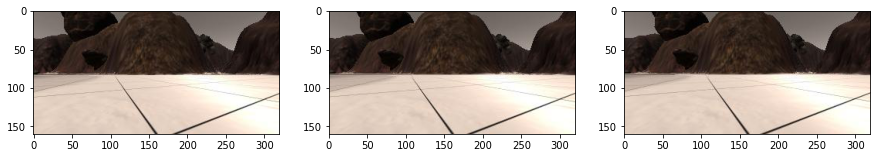

In [11]:
fig,ax = plt.subplots(1,3,figsize = (15,3))

for idx, img_name in enumerate(df['Path'][-3:]):
  img_path = os.path.join(train_path,img_name)
  ax[idx].imshow(img.imread(img_path))
  image = img.imread(img_path)

Dataset Class

In [12]:
class RoboDataset(Dataset):
    def __init__(self, data, path , transform = None):
        super().__init__()
        self.data = data.values
        self.path = path
        self.transform = transform
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self,index):
        img_name,label = self.data[index]
        img_path = os.path.join(self.path, img_name)
        image = Image.open(img_path)
        image = image.resize((128,128))
        image = np.asarray(image)
        #image = color_thresh(image)
        #plt.imshow(threshold_img)
        if self.transform is not None:
            image = self.transform(image)
        return image, label

**Transformers**

In [13]:
train_transform = transforms.Compose([transforms.ToPILImage(),
                                      transforms.ToTensor()])

test_transform = transforms.Compose([transforms.ToPILImage(),
                                     transforms.ToTensor()])

valid_transform = transforms.Compose([transforms.ToPILImage(),
                                     transforms.ToTensor()])

**Split data**

In [15]:
train, valid_data = train_test_split(df, test_size=0.2)


**Tensor data**

In [16]:
train_data = RoboDataset(train, train_path, train_transform )
valid_data = RoboDataset(valid_data, train_path, valid_transform )

**Data loader**

In [17]:
# Hyper parameters

num_epochs = 300
batch_size = 32
learning_rate = 0.001

In [18]:
train_loader = DataLoader(dataset = train_data, batch_size = batch_size, shuffle=True, num_workers=0, drop_last=True)
valid_loader = DataLoader(dataset = valid_data, batch_size = batch_size, shuffle=False, num_workers=0, drop_last=True)

# VGG MODEL

In [23]:
import torchvision.models as models

VGG = models.vgg16(pretrained=True)

In [24]:
for param in VGG.parameters():
    param.requires_grad = False

In [25]:
VGG.classifier = nn.Sequential(*list(VGG.classifier.children())[:-1])
VGG.classifier[2] = torch.nn.Linear(4096, 2048)
VGG.classifier[3] = torch.nn.ReLU()
VGG.classifier[4] = torch.nn.Linear(2048, 2)
VGG.classifier[5] = torch.nn.Sigmoid()

In [26]:
print(VGG)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [27]:
model = VGG.to(device)
criterion = torch.nn.MSELoss()
optimizer = torch.optim.SGD(model.parameters(),lr = learning_rate)

# CNN Model

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()

        self.conv1 = nn.Conv2d(in_channels=3, out_channels=12, kernel_size=3, stride=1, padding=1)
        self.relu1 = nn.ReLU()

        self.conv2 = nn.Conv2d(in_channels=12, out_channels=12, kernel_size=3, stride=1, padding=1)
        self.relu2 = nn.ReLU()

        self.pool = nn.MaxPool2d(kernel_size=2)

        self.conv3 = nn.Conv2d(in_channels=12, out_channels=24, kernel_size=3, stride=1, padding=1)
        self.relu3 = nn.ReLU()

        self.conv4 = nn.Conv2d(in_channels=24, out_channels=24, kernel_size=3, stride=1, padding=1)
        self.relu4 = nn.ReLU()

        self.fc1 = nn.Linear(64 * 64 * 24, 2048)
        self.fc2 = nn.Linear(2048, 128)
        self.fc3 = nn.Linear(128, 2)

    def forward(self, input):
        output = self.conv1(input)
        #print(output.shape)
        output = self.relu1(output)
        #print(output.shape)

        output = self.conv2(output)
        #print(output.shape)
        output = self.relu2(output)
        #print(output.shape)

        output = self.pool(output)
        #print(output.shape)

        output = self.conv3(output)
        #print(output.shape)
        output = self.relu3(output)
        #print(output.shape)

        output = self.conv4(output)
        #print(output.shape)
        output = self.relu4(output)
        #print(output.shape)

        output = output.view(-1, 64 * 64 * 24)
        #print(output.shape)

        output = F.relu(self.fc1(output))
        #output = F.dropout(output, training=self.training)
        output = F.relu(self.fc2(output))
        #output = F.dropout(output, training=self.training)
        output = F.sigmoid(self.fc3(output))

        return output

In [ ]:
model = CNN()
print(model)

CNN(
  (conv1): Conv2d(3, 12, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu1): ReLU()
  (conv2): Conv2d(12, 12, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu2): ReLU()
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv3): Conv2d(12, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu3): ReLU()
  (conv4): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu4): ReLU()
  (fc1): Linear(in_features=98304, out_features=2048, bias=True)
  (fc2): Linear(in_features=2048, out_features=128, bias=True)
  (fc3): Linear(in_features=128, out_features=2, bias=True)
)


In [ ]:
model = CNN().to(device)
criterion = torch.nn.MSELoss()
optimizer = torch.optim.SGD(model.parameters(),lr = learning_rate)

# Training loop

In [29]:
# keeping-track-of-losses 
train_losses = []
valid_losses = []

for epoch in range(1, num_epochs + 1):
    # keep-track-of-training-and-validation-loss
    train_loss = []
    valid_loss = []
    
    # training-the-model
    model.train()
    for data, target in train_loader:
        # move-tensors-to-GPU 
        data = data.to(device)
        target = target.to(device)
        
        # clear-the-gradients-of-all-optimized-variables
        optimizer.zero_grad()
        # forward-pass: compute-predicted-outputs-by-passing-inputs-to-the-model
        output = model(data)
        # calculate-the-batch-loss
        loss = criterion(output.float(), target.float())
        # backward-pass: compute-gradient-of-the-loss-wrt-model-parameters
        loss.backward()
        # perform-a-ingle-optimization-step (parameter-update)
        optimizer.step()
        # update-training-loss
        train_loss.append(loss.item())
        
        
    # validate-the-model
    model.eval()
    for data, target in valid_loader:
        
        data = data.to(device)
        target = target.to(device)

        output = model(data)
        
        loss = criterion(output.float(), target.float())
        
        valid_loss.append(loss.item())
    
    # calculate-average-losses
    train_loss = np.average(train_loss)
    valid_loss = np.average(valid_loss)

        
    # print-training/validation-statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
torch.save(model, 'VGG_3000data_secondmodel_128.pt')

Epoch: 1 	Training Loss: 0.130419 	Validation Loss: 0.124822
Epoch: 2 	Training Loss: 0.124700 	Validation Loss: 0.119606
Epoch: 3 	Training Loss: 0.119664 	Validation Loss: 0.115203
Epoch: 4 	Training Loss: 0.115726 	Validation Loss: 0.111544
Epoch: 5 	Training Loss: 0.111777 	Validation Loss: 0.108304
Epoch: 6 	Training Loss: 0.108425 	Validation Loss: 0.105320
Epoch: 7 	Training Loss: 0.105886 	Validation Loss: 0.102878
Epoch: 8 	Training Loss: 0.103400 	Validation Loss: 0.100860
Epoch: 9 	Training Loss: 0.101100 	Validation Loss: 0.098606
Epoch: 10 	Training Loss: 0.099019 	Validation Loss: 0.096720
Epoch: 11 	Training Loss: 0.097213 	Validation Loss: 0.095040
Epoch: 12 	Training Loss: 0.095406 	Validation Loss: 0.093493
Epoch: 13 	Training Loss: 0.093659 	Validation Loss: 0.092012
Epoch: 14 	Training Loss: 0.092745 	Validation Loss: 0.090553
Epoch: 15 	Training Loss: 0.091275 	Validation Loss: 0.089355
Epoch: 16 	Training Loss: 0.089602 	Validation Loss: 0.088167
Epoch: 17 	Traini

# Testing

In [30]:
test_path = '/content/drive/MyDrive/test_data/IMG'
df_test = pd.read_csv("/content/drive/MyDrive/test_data/robot_log.csv",delimiter=";")
df_test['SteerAngle_normal'] = df_test['SteerAngle'].apply(lambda x: (x+15)/30) 
df_test['SteerAngle+Throttle'] = df_test[['SteerAngle_normal','Throttle']].apply(lambda x: pd.Series([x.values]), axis=1)
df_test = df_test.drop(labels=['Brake','Speed', 'X_Position', 'Y_Position', 'Roll', 'Pitch', 'Yaw','SteerAngle','Throttle','SteerAngle_normal'], axis=1)
test_data = df_test
print(df_test.shape)

test_transform = transforms.Compose([transforms.ToPILImage(),
                                     transforms.ToTensor()])

test_data = RoboDataset(test_data, test_path, test_transform )

test_loader = DataLoader(dataset = test_data, batch_size = 1, shuffle=False, num_workers=0, drop_last=True)

(332, 2)


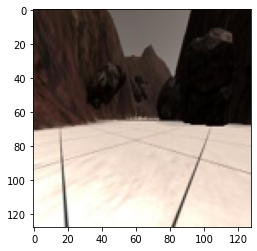

Steerangle_output = -3.497194290161133
Steerangle_target = 0.0
Throttle_output = 0.2295493185520172
Throttle_target = 0.0
1


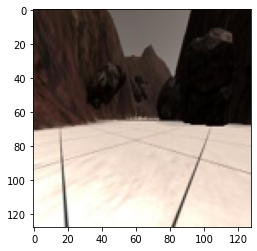

Steerangle_output = -3.497194290161133
Steerangle_target = 0.0
Throttle_output = 0.2295493185520172
Throttle_target = 0.0
2


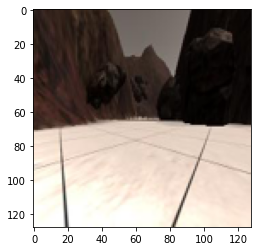

Steerangle_output = -3.505021095275879
Steerangle_target = 0.0
Throttle_output = 0.22829993069171906
Throttle_target = 0.0
3


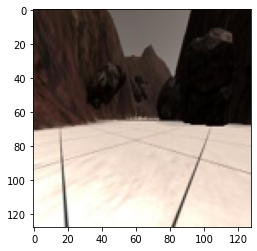

Steerangle_output = -3.497194290161133
Steerangle_target = 0.0
Throttle_output = 0.2295493185520172
Throttle_target = 0.0
4


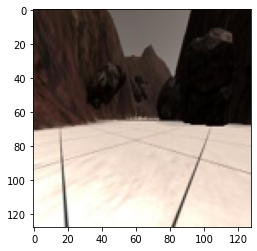

Steerangle_output = -3.497194290161133
Steerangle_target = 0.0
Throttle_output = 0.2295493185520172
Throttle_target = 0.0
5


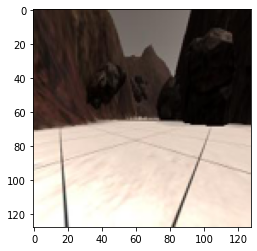

Steerangle_output = -3.48197078704834
Steerangle_target = 0.0
Throttle_output = 0.22793331742286682
Throttle_target = 0.0
6


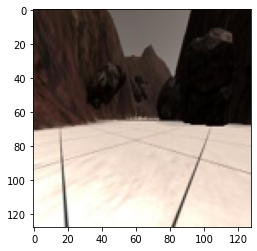

Steerangle_output = -3.497194290161133
Steerangle_target = 0.0
Throttle_output = 0.2295493185520172
Throttle_target = 0.0
7


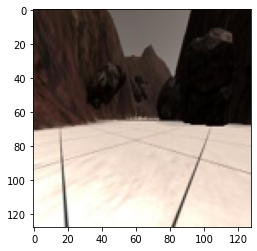

Steerangle_output = -3.497194290161133
Steerangle_target = 0.0
Throttle_output = 0.2295493185520172
Throttle_target = 0.0
8


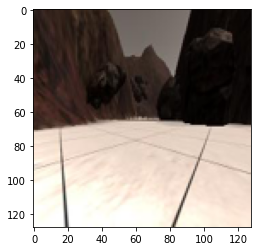

Steerangle_output = -3.505021095275879
Steerangle_target = 0.0
Throttle_output = 0.22829993069171906
Throttle_target = 0.0
9


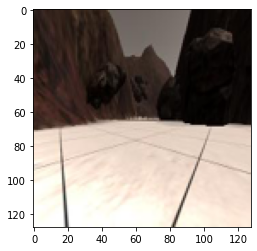

Steerangle_output = -3.496248245239258
Steerangle_target = 0.0
Throttle_output = 0.22950991988182068
Throttle_target = 0.0
10


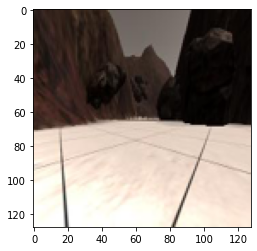

Steerangle_output = -3.496248245239258
Steerangle_target = 0.0
Throttle_output = 0.22950991988182068
Throttle_target = 0.0
11


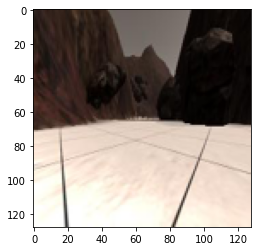

Steerangle_output = -3.513425827026367
Steerangle_target = 0.0
Throttle_output = 0.24160155653953552
Throttle_target = 0.1004808
12


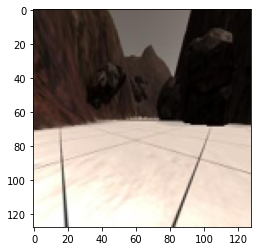

Steerangle_output = -3.7872095108032227
Steerangle_target = 0.0
Throttle_output = 0.27325549721717834
Throttle_target = 0.3019824
13


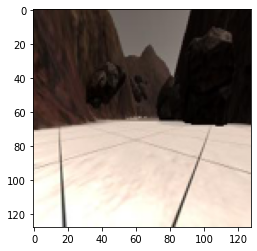

Steerangle_output = -3.3677215576171875
Steerangle_target = 0.0
Throttle_output = 0.31028151512145996
Throttle_target = 0.5005692
14


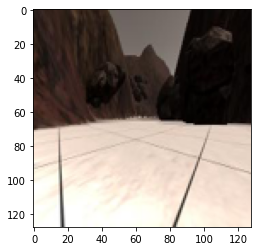

Steerangle_output = -2.9764575958251953
Steerangle_target = 0.0
Throttle_output = 0.2762012481689453
Throttle_target = 0.7007478
15


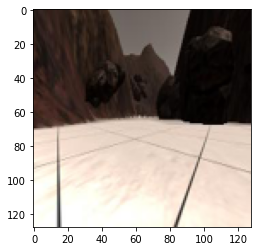

Steerangle_output = -1.6925125122070312
Steerangle_target = 0.0
Throttle_output = 0.43993452191352844
Throttle_target = 0.9013218000000001
16


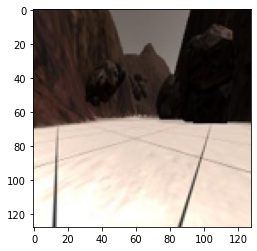

Steerangle_output = -2.447572708129883
Steerangle_target = 0.0
Throttle_output = 0.40225112438201904
Throttle_target = 1.0
17


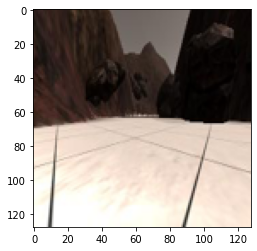

Steerangle_output = -2.441661834716797
Steerangle_target = 0.0
Throttle_output = 0.5353509783744812
Throttle_target = 1.0
18


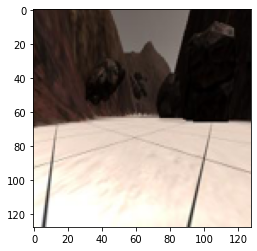

Steerangle_output = -2.479050636291504
Steerangle_target = 0.0
Throttle_output = 0.5637029409408569
Throttle_target = 1.0
19


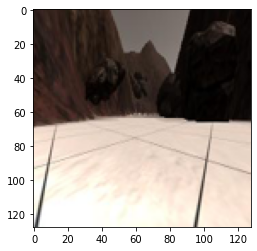

Steerangle_output = -3.784939765930176
Steerangle_target = 0.0
Throttle_output = 0.5122498869895935
Throttle_target = 1.0
20


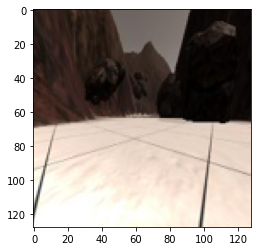

Steerangle_output = -4.543712615966797
Steerangle_target = -1.5044269999999997
Throttle_output = 0.6645256876945496
Throttle_target = 1.0
21


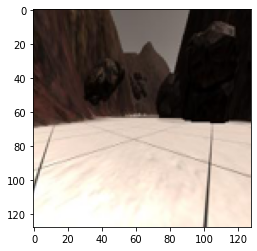

Steerangle_output = -5.471853256225586
Steerangle_target = -4.499469000000001
Throttle_output = 0.7328221797943115
Throttle_target = 1.0
22


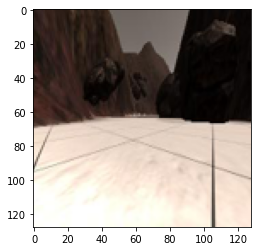

Steerangle_output = -6.731072425842285
Steerangle_target = -7.509574000000001
Throttle_output = 0.6080424189567566
Throttle_target = 1.0
23


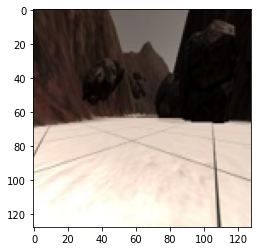

Steerangle_output = -5.7706708908081055
Steerangle_target = -10.50859
Throttle_output = 0.5511673092842102
Throttle_target = 1.0
24


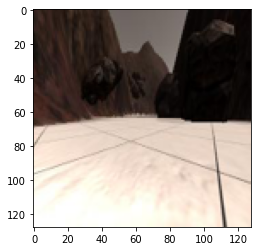

Steerangle_output = -4.609560012817383
Steerangle_target = -13.51079
Throttle_output = 0.5033913254737854
Throttle_target = 1.0
25


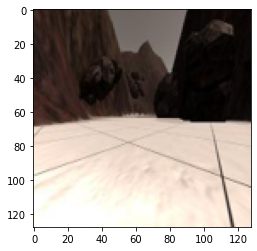

Steerangle_output = -2.133784294128418
Steerangle_target = -15.0
Throttle_output = 0.6770517826080322
Throttle_target = 1.0
26


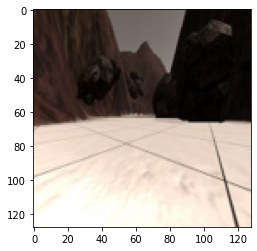

Steerangle_output = -1.6347475051879883
Steerangle_target = -15.0
Throttle_output = 0.7977548837661743
Throttle_target = 1.0
27


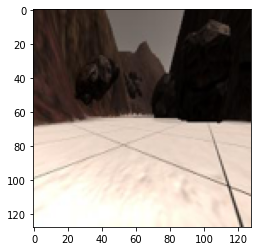

Steerangle_output = -1.5648908615112305
Steerangle_target = -15.0
Throttle_output = 0.8933813571929932
Throttle_target = 1.0
28


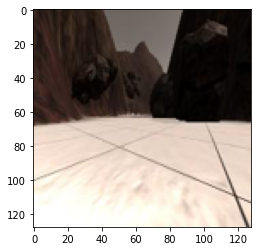

Steerangle_output = -1.1261959075927734
Steerangle_target = -15.0
Throttle_output = 0.9008767008781433
Throttle_target = 1.0
29


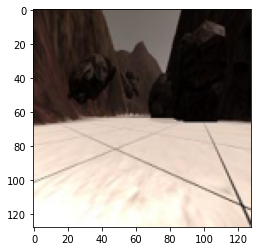

Steerangle_output = 1.0409908294677734
Steerangle_target = -15.0
Throttle_output = 0.9318742156028748
Throttle_target = 1.0
30


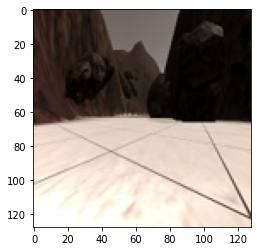

Steerangle_output = 0.14447307586669922
Steerangle_target = -15.0
Throttle_output = 0.9285047650337219
Throttle_target = 1.0
31


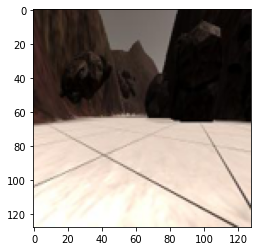

Steerangle_output = -0.5700616836547852
Steerangle_target = -15.0
Throttle_output = 0.9097391963005066
Throttle_target = 1.0
32


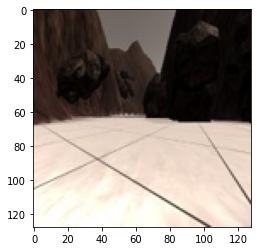

Steerangle_output = 0.4824686050415039
Steerangle_target = -15.0
Throttle_output = 0.9025141000747681
Throttle_target = 1.0
33


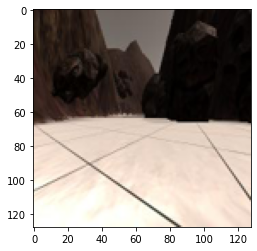

Steerangle_output = 1.8688068389892578
Steerangle_target = -15.0
Throttle_output = 0.8701868057250977
Throttle_target = 1.0
34


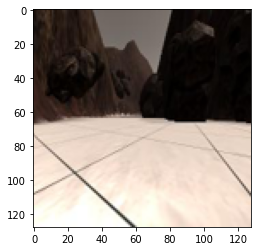

Steerangle_output = 1.1226768493652344
Steerangle_target = -15.0
Throttle_output = 0.7250105142593384
Throttle_target = 1.0
35


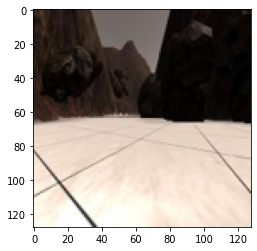

Steerangle_output = 0.06360244750976562
Steerangle_target = -15.0
Throttle_output = 0.7087026238441467
Throttle_target = 1.0
36


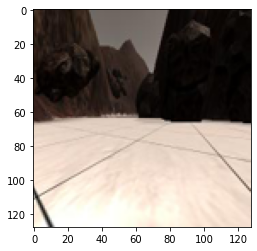

Steerangle_output = -2.141204833984375
Steerangle_target = -15.0
Throttle_output = 0.40481817722320557
Throttle_target = 1.0
37


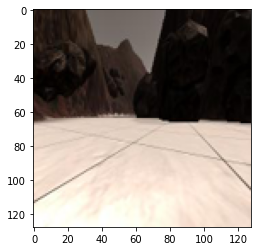

Steerangle_output = 0.32358360290527344
Steerangle_target = -15.0
Throttle_output = 0.8388943672180176
Throttle_target = 1.0
38


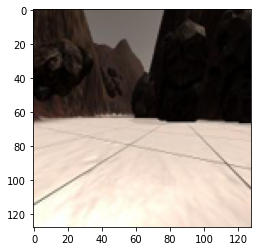

Steerangle_output = -0.726069450378418
Steerangle_target = -15.0
Throttle_output = 0.8683915138244629
Throttle_target = 1.0
39


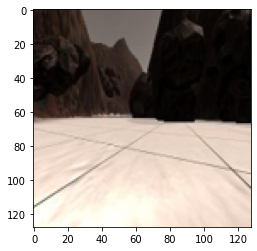

Steerangle_output = -1.2047119140625
Steerangle_target = -15.0
Throttle_output = 0.8775580525398254
Throttle_target = 1.0
40


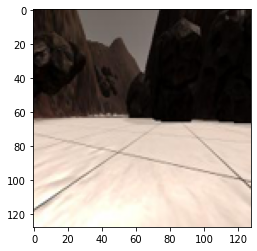

Steerangle_output = -0.6413021087646484
Steerangle_target = -15.0
Throttle_output = 0.8251835703849792
Throttle_target = 1.0
41


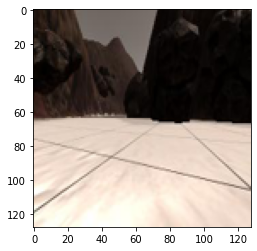

Steerangle_output = -0.6851892471313477
Steerangle_target = -15.0
Throttle_output = 0.8803557753562927
Throttle_target = 1.0
42


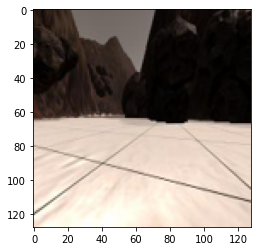

Steerangle_output = 2.8117828369140625
Steerangle_target = -15.0
Throttle_output = 0.9251060485839844
Throttle_target = 1.0
43


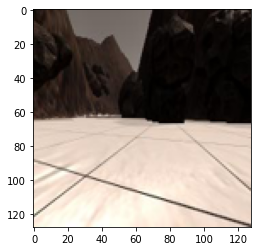

Steerangle_output = 3.7473201751708984
Steerangle_target = -15.0
Throttle_output = 0.9358315467834473
Throttle_target = 1.0
44


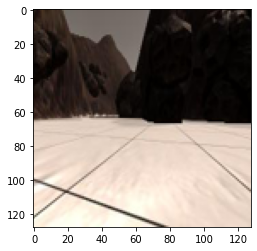

Steerangle_output = 2.5094432830810547
Steerangle_target = -15.0
Throttle_output = 0.8816027641296387
Throttle_target = 1.0
45


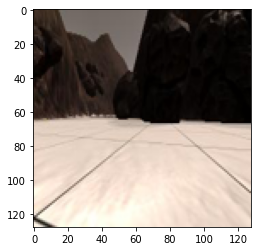

Steerangle_output = 2.2148990631103516
Steerangle_target = -15.0
Throttle_output = 0.8534841537475586
Throttle_target = 1.0
46


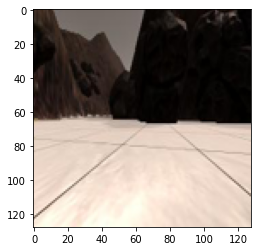

Steerangle_output = 4.520473480224609
Steerangle_target = -13.490829999999999
Throttle_output = 0.9373563528060913
Throttle_target = 1.0
47


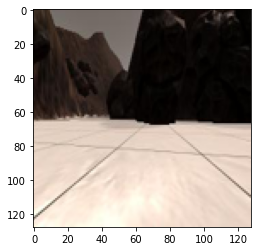

Steerangle_output = 5.133150100708008
Steerangle_target = -10.49816
Throttle_output = 0.9507366418838501
Throttle_target = 1.0
48


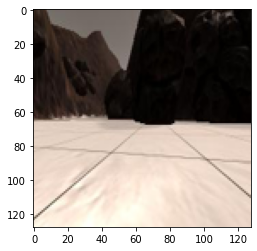

Steerangle_output = 4.614557266235352
Steerangle_target = -7.494599
Throttle_output = 0.9251818656921387
Throttle_target = 1.0
49


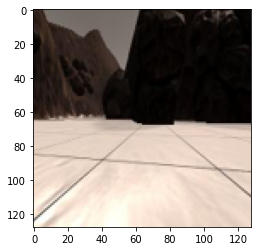

Steerangle_output = 4.0428466796875
Steerangle_target = -4.490110999999999
Throttle_output = 0.8794283270835876
Throttle_target = 1.0
50


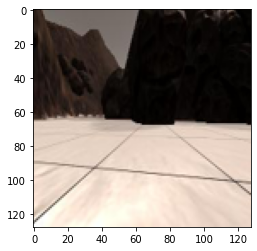

Steerangle_output = 4.389505386352539
Steerangle_target = -1.4854559999999992
Throttle_output = 0.8989534378051758
Throttle_target = 1.0
51


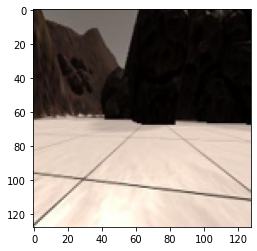

Steerangle_output = 5.357212066650391
Steerangle_target = 0.0
Throttle_output = 0.9385460019111633
Throttle_target = 1.0
52


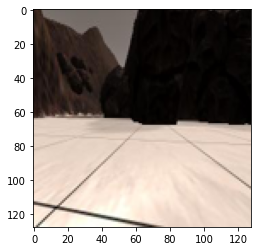

Steerangle_output = 4.857486724853516
Steerangle_target = 0.0
Throttle_output = 0.9453563094139099
Throttle_target = 1.0
53


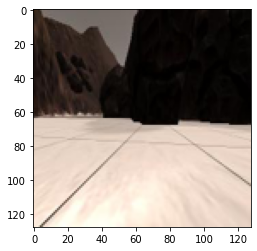

Steerangle_output = -0.24219036102294922
Steerangle_target = 0.0
Throttle_output = 0.8248440623283386
Throttle_target = 1.0
54


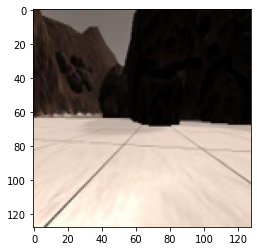

Steerangle_output = 1.7448101043701172
Steerangle_target = 0.0
Throttle_output = 0.8048245310783386
Throttle_target = 1.0
55


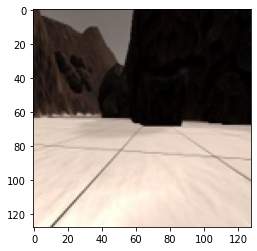

Steerangle_output = 2.616518020629883
Steerangle_target = 0.0
Throttle_output = 0.896146833896637
Throttle_target = 1.0
56


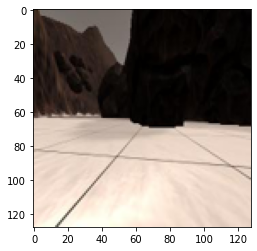

Steerangle_output = 2.6586780548095703
Steerangle_target = 0.0
Throttle_output = 0.9182910323143005
Throttle_target = 1.0
57


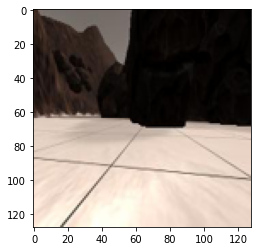

Steerangle_output = 4.396915435791016
Steerangle_target = 0.0
Throttle_output = 0.9271035194396973
Throttle_target = 1.0
58


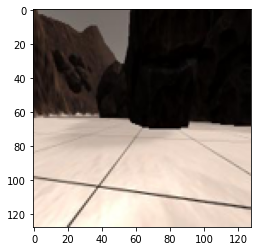

Steerangle_output = 4.2648773193359375
Steerangle_target = 0.0
Throttle_output = 0.8925536870956421
Throttle_target = 1.0
59


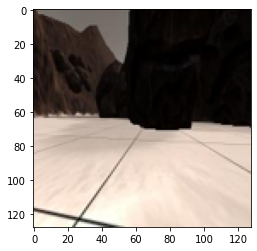

Steerangle_output = 4.159921646118164
Steerangle_target = 1.5084310000000016
Throttle_output = 0.8969009518623352
Throttle_target = 1.0
60


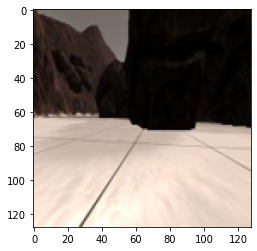

Steerangle_output = 1.0357990264892578
Steerangle_target = 4.4905100000000004
Throttle_output = 0.908257007598877
Throttle_target = 1.0
61


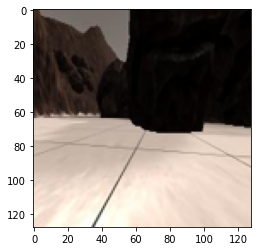

Steerangle_output = 2.4767837524414062
Steerangle_target = 7.508313000000001
Throttle_output = 0.7470186352729797
Throttle_target = 1.0
62


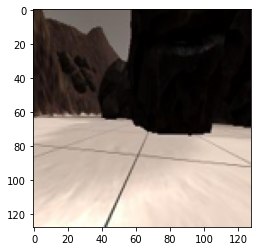

Steerangle_output = 4.270519256591797
Steerangle_target = 10.51304
Throttle_output = 0.7764355540275574
Throttle_target = 1.0
63


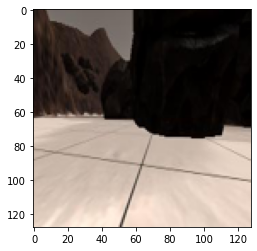

Steerangle_output = 4.811397552490234
Steerangle_target = 13.5149
Throttle_output = 0.8858946561813354
Throttle_target = 1.0
64


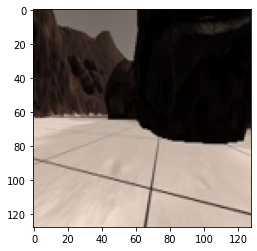

Steerangle_output = 5.048574447631836
Steerangle_target = 15.0
Throttle_output = 0.9274986982345581
Throttle_target = 1.0
65


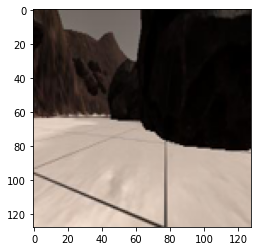

Steerangle_output = 6.319097518920898
Steerangle_target = 15.0
Throttle_output = 0.9546278715133667
Throttle_target = 1.0
66


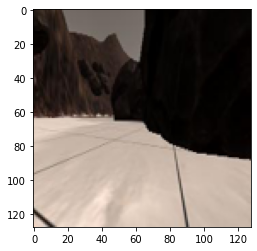

Steerangle_output = 3.816629409790039
Steerangle_target = 15.0
Throttle_output = 0.9742436408996582
Throttle_target = 1.0
67


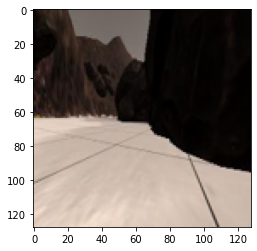

Steerangle_output = 2.971385955810547
Steerangle_target = 15.0
Throttle_output = 0.9510788917541504
Throttle_target = 1.0
68


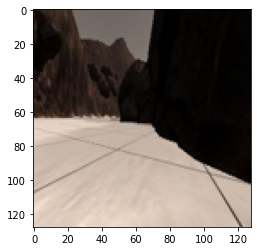

Steerangle_output = 2.859577178955078
Steerangle_target = 15.0
Throttle_output = 0.9196072816848755
Throttle_target = 1.0
69


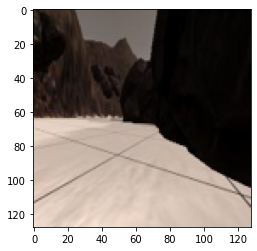

Steerangle_output = 3.356901168823242
Steerangle_target = 15.0
Throttle_output = 0.8944545388221741
Throttle_target = 1.0
70


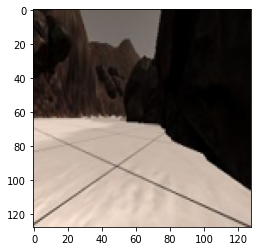

Steerangle_output = 3.472400665283203
Steerangle_target = 15.0
Throttle_output = 0.9172123074531555
Throttle_target = 1.0
71


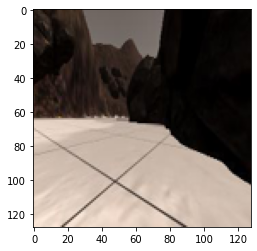

Steerangle_output = 3.0721817016601562
Steerangle_target = 12.010559999999998
Throttle_output = 0.9306646585464478
Throttle_target = 1.0
72


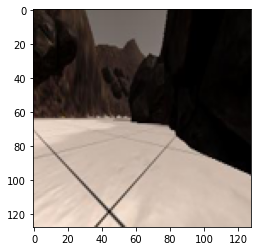

Steerangle_output = 1.0214805603027344
Steerangle_target = 9.008808000000002
Throttle_output = 0.9392784833908081
Throttle_target = 1.0
73


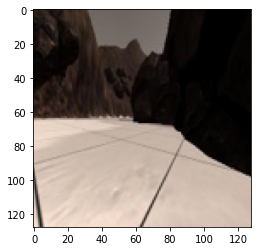

Steerangle_output = 1.6975860595703125
Steerangle_target = 5.9960629999999995
Throttle_output = 0.7329006791114807
Throttle_target = 1.0
74


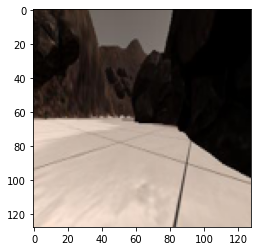

Steerangle_output = 3.664642333984375
Steerangle_target = 3.0117210000000014
Throttle_output = 0.8550384640693665
Throttle_target = 1.0
75


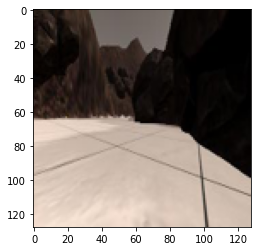

Steerangle_output = 1.0018882751464844
Steerangle_target = 0.0
Throttle_output = 0.9221787452697754
Throttle_target = 1.0
76


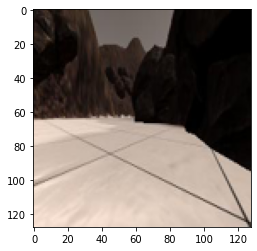

Steerangle_output = 0.4925050735473633
Steerangle_target = 0.0
Throttle_output = 0.9085046648979187
Throttle_target = 1.0
77


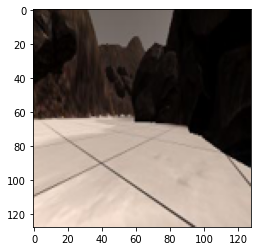

Steerangle_output = 1.2201862335205078
Steerangle_target = 0.0
Throttle_output = 0.9512132406234741
Throttle_target = 1.0
78


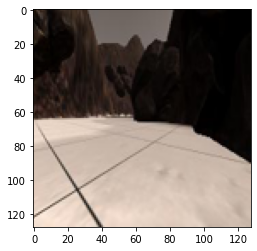

Steerangle_output = 2.3547134399414062
Steerangle_target = 0.0
Throttle_output = 0.9867858290672302
Throttle_target = 1.0
79


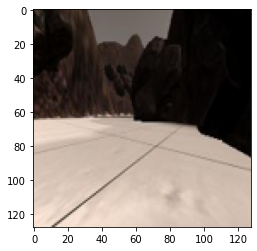

Steerangle_output = 2.0888328552246094
Steerangle_target = 0.0
Throttle_output = 0.9823022484779358
Throttle_target = 1.0
80


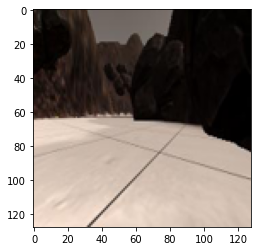

Steerangle_output = 1.9571285247802734
Steerangle_target = 0.0
Throttle_output = 0.9828846454620361
Throttle_target = 1.0
81


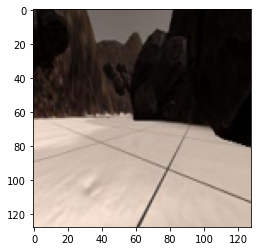

Steerangle_output = 1.2133197784423828
Steerangle_target = 0.0
Throttle_output = 0.9789900183677673
Throttle_target = 1.0
82


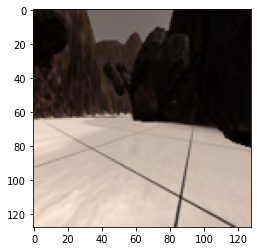

Steerangle_output = -1.3596820831298828
Steerangle_target = 0.0
Throttle_output = 0.9791836738586426
Throttle_target = 1.0
83


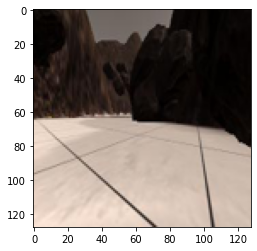

Steerangle_output = 1.059183120727539
Steerangle_target = 0.0
Throttle_output = 0.9891752600669861
Throttle_target = 1.0
84


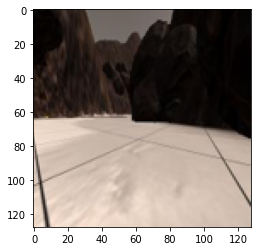

Steerangle_output = -0.8419208526611328
Steerangle_target = 0.0
Throttle_output = 0.8945647478103638
Throttle_target = 1.0
85


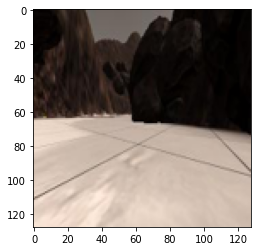

Steerangle_output = 1.4525814056396484
Steerangle_target = 3.0009419999999984
Throttle_output = 0.9840943217277527
Throttle_target = 1.0
86


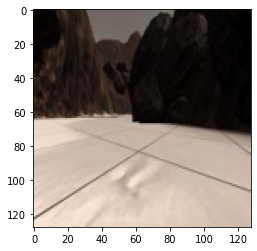

Steerangle_output = 2.1940174102783203
Steerangle_target = 6.0084230000000005
Throttle_output = 0.9841166138648987
Throttle_target = 1.0
87


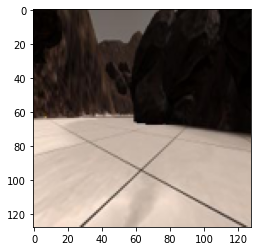

Steerangle_output = 3.4007034301757812
Steerangle_target = 9.020195999999999
Throttle_output = 0.9875778555870056
Throttle_target = 1.0
88


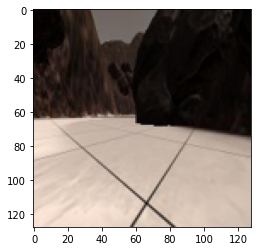

Steerangle_output = 4.525333404541016
Steerangle_target = 12.015839999999997
Throttle_output = 0.9938437938690186
Throttle_target = 1.0
89


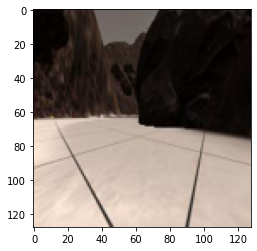

Steerangle_output = 5.202482223510742
Steerangle_target = 15.0
Throttle_output = 0.9849112033843994
Throttle_target = 1.0
90


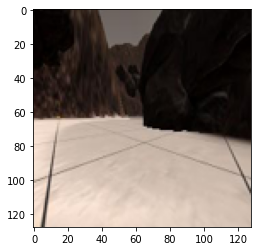

Steerangle_output = 5.664798736572266
Steerangle_target = 15.0
Throttle_output = 0.9906725287437439
Throttle_target = 1.0
91


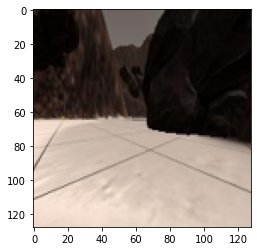

Steerangle_output = 7.349338531494141
Steerangle_target = 15.0
Throttle_output = 0.9793775677680969
Throttle_target = 1.0
92


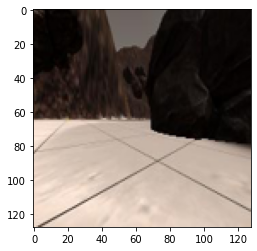

Steerangle_output = 6.555929183959961
Steerangle_target = 15.0
Throttle_output = 0.9430673122406006
Throttle_target = 1.0
93


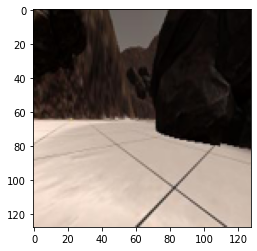

Steerangle_output = 7.108234405517578
Steerangle_target = 15.0
Throttle_output = 0.9250904321670532
Throttle_target = 1.0
94


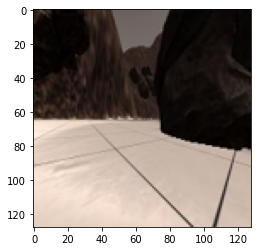

Steerangle_output = 6.114206314086914
Steerangle_target = 15.0
Throttle_output = 0.9534542560577393
Throttle_target = 1.0
95


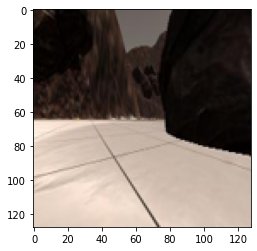

Steerangle_output = 7.305255889892578
Steerangle_target = 13.500250000000001
Throttle_output = 0.9682010412216187
Throttle_target = 1.0
96


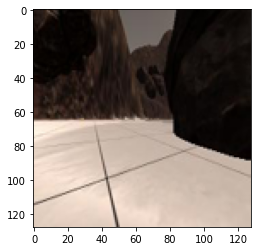

Steerangle_output = 7.359691619873047
Steerangle_target = 10.50235
Throttle_output = 0.9493024349212646
Throttle_target = 1.0
97


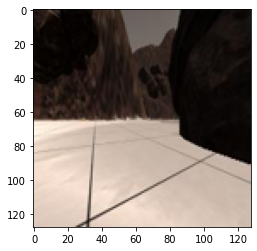

Steerangle_output = 4.196561813354492
Steerangle_target = 7.499179999999999
Throttle_output = 0.8787500858306885
Throttle_target = 1.0
98


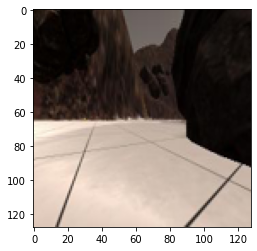

Steerangle_output = 6.99824333190918
Steerangle_target = 4.491433999999998
Throttle_output = 0.8453370332717896
Throttle_target = 1.0
99


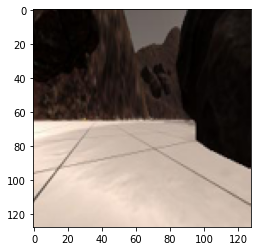

Steerangle_output = 0.3812990188598633
Steerangle_target = 1.4910360000000011
Throttle_output = 0.9115486741065979
Throttle_target = 1.0
100


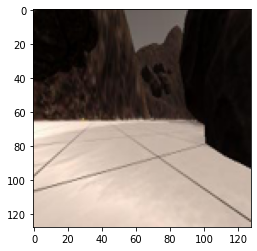

Steerangle_output = 0.9640579223632812
Steerangle_target = 0.0
Throttle_output = 0.7806937098503113
Throttle_target = 1.0
101


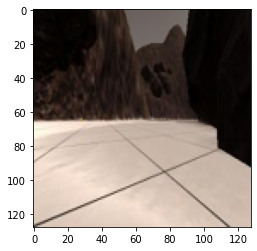

Steerangle_output = -0.3252544403076172
Steerangle_target = 0.0
Throttle_output = 0.6364360451698303
Throttle_target = 1.0
102


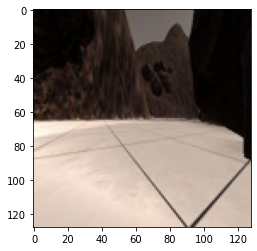

Steerangle_output = -1.384225845336914
Steerangle_target = 0.0
Throttle_output = 0.9111303091049194
Throttle_target = 1.0
103


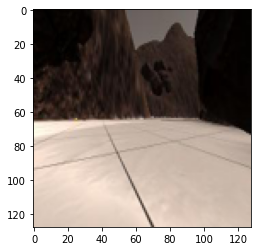

Steerangle_output = -2.0307016372680664
Steerangle_target = 0.0
Throttle_output = 0.9381701350212097
Throttle_target = 1.0
104


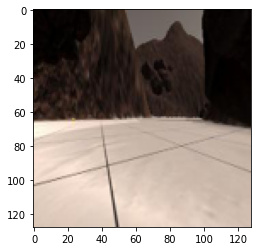

Steerangle_output = 0.04844474792480469
Steerangle_target = 0.0
Throttle_output = 0.8612074851989746
Throttle_target = 1.0
105


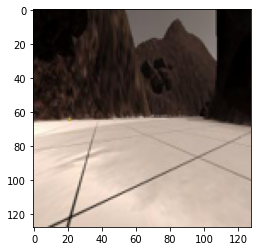

Steerangle_output = -2.6845836639404297
Steerangle_target = 0.0
Throttle_output = 0.9134024977684021
Throttle_target = 1.0
106


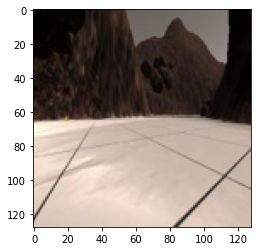

Steerangle_output = -3.4418439865112305
Steerangle_target = 0.0
Throttle_output = 0.8703730702400208
Throttle_target = 1.0
107


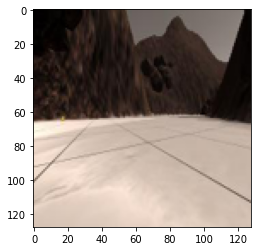

Steerangle_output = -5.050023078918457
Steerangle_target = 0.0
Throttle_output = 0.8957101106643677
Throttle_target = 1.0
108


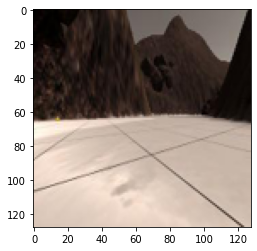

Steerangle_output = -4.028358459472656
Steerangle_target = 0.0
Throttle_output = 0.9468228220939636
Throttle_target = 1.0
109


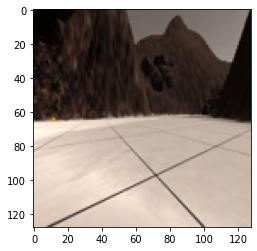

Steerangle_output = -3.765547752380371
Steerangle_target = 0.0
Throttle_output = 0.8935730457305908
Throttle_target = 1.0
110


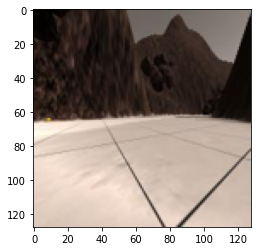

Steerangle_output = -3.4605093002319336
Steerangle_target = 0.0
Throttle_output = 0.9349461793899536
Throttle_target = 1.0
111


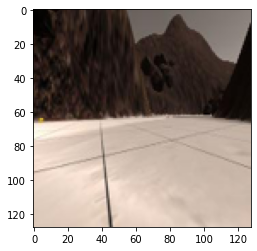

Steerangle_output = -4.911561965942383
Steerangle_target = 1.506812
Throttle_output = 0.9462796449661255
Throttle_target = 1.0
112


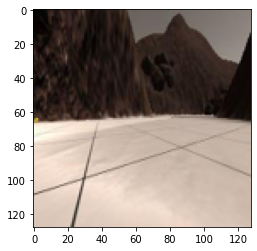

Steerangle_output = -4.0385894775390625
Steerangle_target = 4.5011839999999985
Throttle_output = 0.9188066124916077
Throttle_target = 1.0
113


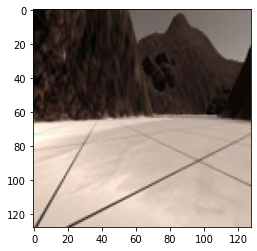

Steerangle_output = -4.137377738952637
Steerangle_target = 7.506233999999999
Throttle_output = 0.7940501570701599
Throttle_target = 1.0
114


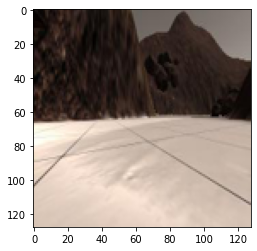

Steerangle_output = -5.461729049682617
Steerangle_target = 10.508029999999998
Throttle_output = 0.8542113304138184
Throttle_target = 1.0
115


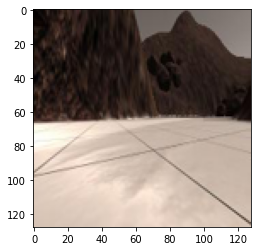

Steerangle_output = -3.7401227951049805
Steerangle_target = 10.49728
Throttle_output = 0.8333321213722229
Throttle_target = 1.0
116


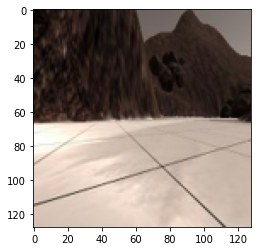

Steerangle_output = -3.26094913482666
Steerangle_target = 7.514185000000001
Throttle_output = 0.8490487337112427
Throttle_target = 1.0
117


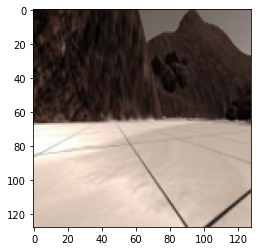

Steerangle_output = -2.8176279067993164
Steerangle_target = 4.49671
Throttle_output = 0.3786567151546478
Throttle_target = 0.7988350000000001
118


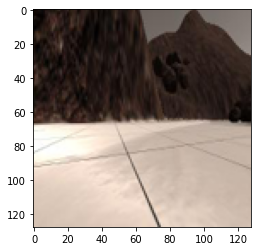

Steerangle_output = -3.07843017578125
Steerangle_target = 1.4939089999999986
Throttle_output = 0.5264216661453247
Throttle_target = 0.5986484000000001
119


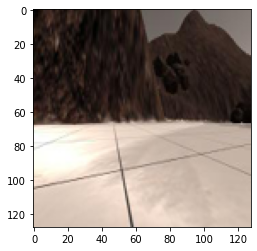

Steerangle_output = -5.331687927246094
Steerangle_target = 0.0
Throttle_output = 0.252686083316803
Throttle_target = 0.3980108
120


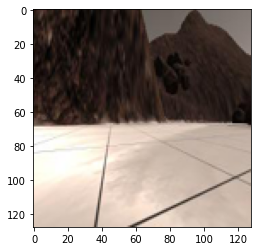

Steerangle_output = -5.707036018371582
Steerangle_target = 0.0
Throttle_output = 0.45811739563941956
Throttle_target = 0.1971509
121


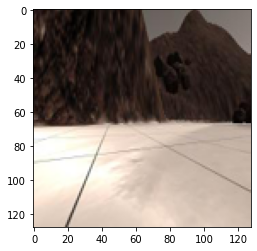

Steerangle_output = -5.438755989074707
Steerangle_target = 0.0
Throttle_output = 0.37337416410446167
Throttle_target = 0.0
122


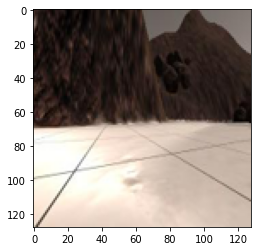

Steerangle_output = -2.8222484588623047
Steerangle_target = -2.997765000000001
Throttle_output = 0.5379548668861389
Throttle_target = 0.0
123


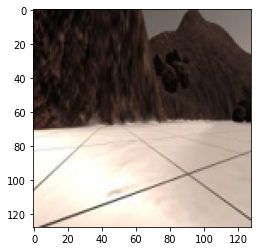

Steerangle_output = -4.802087783813477
Steerangle_target = -5.9897290000000005
Throttle_output = 0.25708460807800293
Throttle_target = 0.0
124


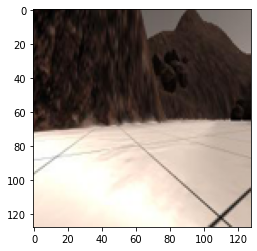

Steerangle_output = -3.526211738586426
Steerangle_target = -8.993907
Throttle_output = 0.24441242218017578
Throttle_target = 0.0
125


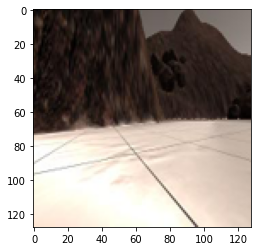

Steerangle_output = -3.853816032409668
Steerangle_target = -11.99822
Throttle_output = 0.3802523910999298
Throttle_target = 0.0
126


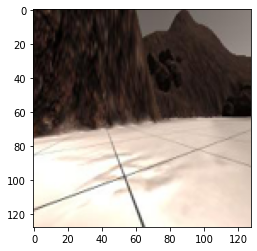

Steerangle_output = 0.6202878952026367
Steerangle_target = -15.0
Throttle_output = 0.31126415729522705
Throttle_target = 0.0
127


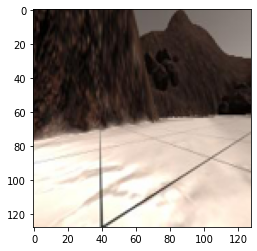

Steerangle_output = -4.161968231201172
Steerangle_target = -15.0
Throttle_output = 0.08120274543762207
Throttle_target = 0.0
128


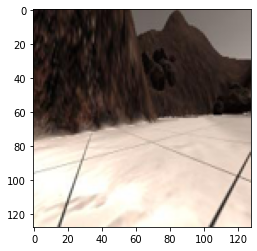

Steerangle_output = -0.5754623413085938
Steerangle_target = -15.0
Throttle_output = 0.499813973903656
Throttle_target = 0.0
129


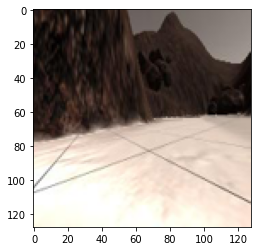

Steerangle_output = -2.992354393005371
Steerangle_target = -15.0
Throttle_output = 0.26222193241119385
Throttle_target = 0.0
130


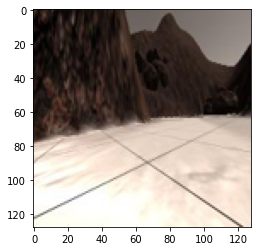

Steerangle_output = -4.867300987243652
Steerangle_target = -15.0
Throttle_output = 0.11043818295001984
Throttle_target = 0.0
131


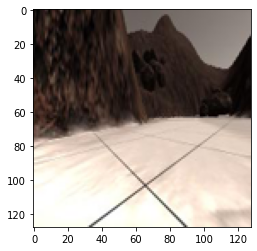

Steerangle_output = -6.437381744384766
Steerangle_target = -15.0
Throttle_output = 0.12109849601984024
Throttle_target = 0.0
132


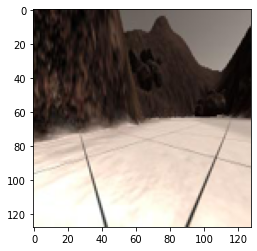

Steerangle_output = -5.863651275634766
Steerangle_target = -13.504629999999999
Throttle_output = 0.07620041072368622
Throttle_target = 0.0
133


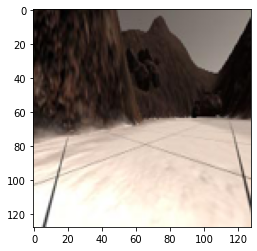

Steerangle_output = -6.931527137756348
Steerangle_target = -10.505410000000001
Throttle_output = 0.5717971920967102
Throttle_target = 0.0
134


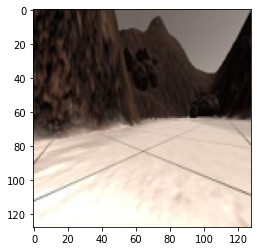

Steerangle_output = -4.830504417419434
Steerangle_target = -7.484807000000002
Throttle_output = 0.6921959519386292
Throttle_target = 0.0
135


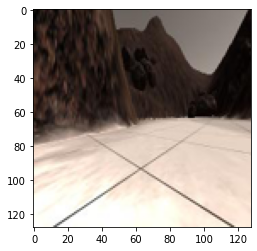

Steerangle_output = -6.858878135681152
Steerangle_target = -4.493409
Throttle_output = 0.1616848260164261
Throttle_target = 0.0
136


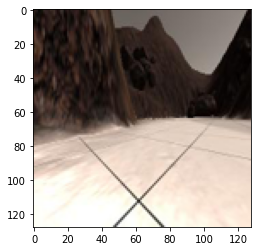

Steerangle_output = -7.87324333190918
Steerangle_target = -1.4914050000000003
Throttle_output = 0.5788815021514893
Throttle_target = 0.0
137


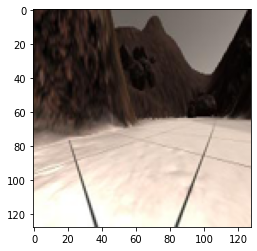

Steerangle_output = -6.161310195922852
Steerangle_target = 0.0
Throttle_output = 0.2945760488510132
Throttle_target = 0.0
138


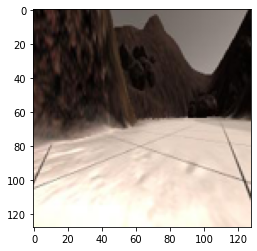

Steerangle_output = -6.378421783447266
Steerangle_target = 0.0
Throttle_output = 0.5423388481140137
Throttle_target = 0.0
139


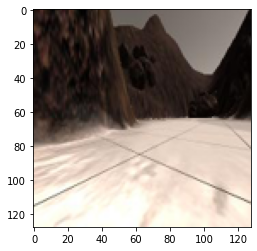

Steerangle_output = -8.270909309387207
Steerangle_target = 0.0
Throttle_output = 0.11917510628700256
Throttle_target = 0.0
140


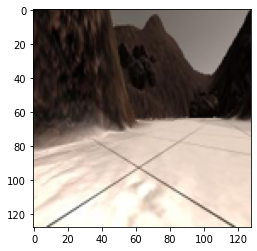

Steerangle_output = -6.157987594604492
Steerangle_target = 0.0
Throttle_output = 0.1737155169248581
Throttle_target = 0.0
141


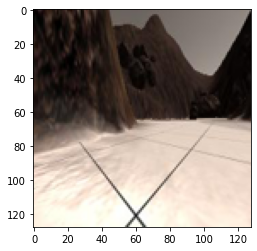

Steerangle_output = -7.71708869934082
Steerangle_target = 0.0
Throttle_output = 0.1818685084581375
Throttle_target = 0.0
142


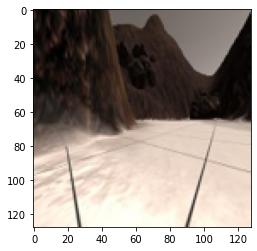

Steerangle_output = -8.759538650512695
Steerangle_target = -2.9973240000000008
Throttle_output = 0.07041152566671371
Throttle_target = 0.0
143


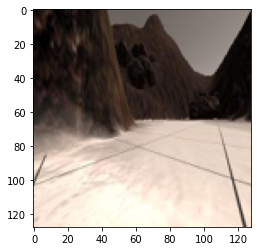

Steerangle_output = -8.256932258605957
Steerangle_target = -6.006789000000001
Throttle_output = 0.0460309199988842
Throttle_target = 0.0
144


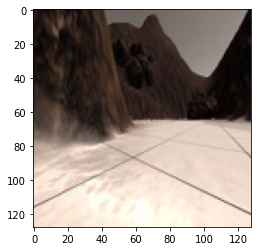

Steerangle_output = -6.247879981994629
Steerangle_target = -9.008303
Throttle_output = 0.1459731012582779
Throttle_target = 0.0
145


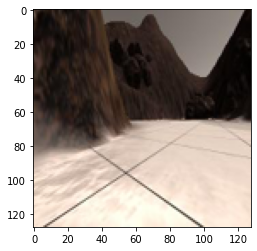

Steerangle_output = -5.658877372741699
Steerangle_target = -12.01321
Throttle_output = 0.1324039101600647
Throttle_target = 0.0
146


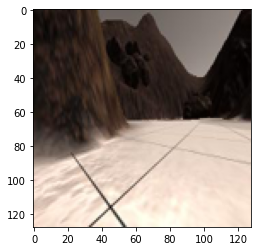

Steerangle_output = -4.7494707107543945
Steerangle_target = -9.009008999999999
Throttle_output = 0.08622780442237854
Throttle_target = 0.0
147


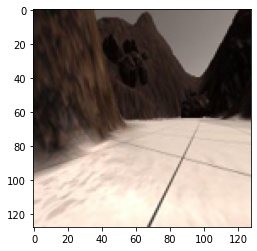

Steerangle_output = -5.547697067260742
Steerangle_target = -6.0033650000000005
Throttle_output = 0.009821662679314613
Throttle_target = 0.0
148


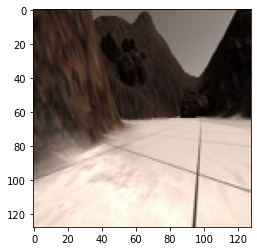

Steerangle_output = -8.310236930847168
Steerangle_target = -3.0112419999999993
Throttle_output = 0.013406181707978249
Throttle_target = 0.0
149


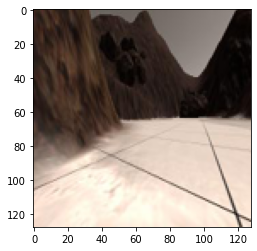

Steerangle_output = -5.804764747619629
Steerangle_target = -0.005183704000000233
Throttle_output = 0.09631885588169098
Throttle_target = 0.0
150


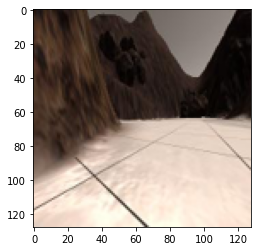

Steerangle_output = -4.602237701416016
Steerangle_target = 0.0
Throttle_output = 0.21848824620246887
Throttle_target = 0.0
151


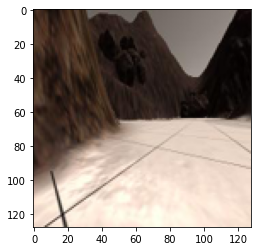

Steerangle_output = -7.088077068328857
Steerangle_target = 0.0
Throttle_output = 0.2038499116897583
Throttle_target = 0.0
152


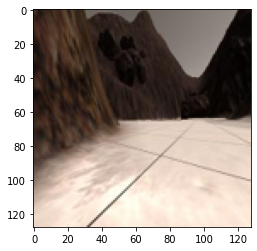

Steerangle_output = -6.22667121887207
Steerangle_target = 0.0
Throttle_output = 0.14815989136695862
Throttle_target = 0.0
153


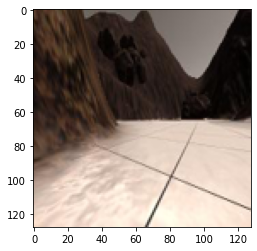

Steerangle_output = -6.2203168869018555
Steerangle_target = 0.0
Throttle_output = 0.04927154257893562
Throttle_target = 0.0
154


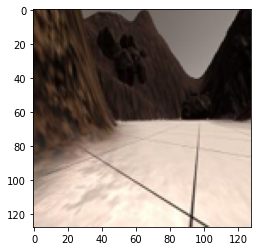

Steerangle_output = -5.633008003234863
Steerangle_target = 0.0
Throttle_output = 0.06867027282714844
Throttle_target = 0.0
155


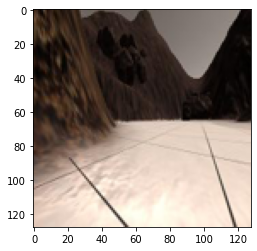

Steerangle_output = -6.667339324951172
Steerangle_target = 0.0
Throttle_output = 0.11116812378168106
Throttle_target = 0.0
156


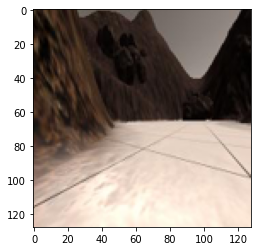

Steerangle_output = -9.543434143066406
Steerangle_target = 0.0
Throttle_output = 0.13893438875675201
Throttle_target = 0.0
157


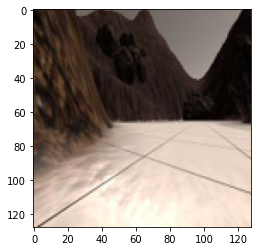

Steerangle_output = -9.05406379699707
Steerangle_target = 0.0
Throttle_output = 0.11952769011259079
Throttle_target = 0.0
158


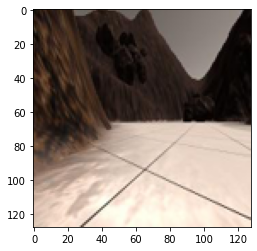

Steerangle_output = -7.141124725341797
Steerangle_target = 0.0
Throttle_output = 0.06389734894037247
Throttle_target = 0.0
159


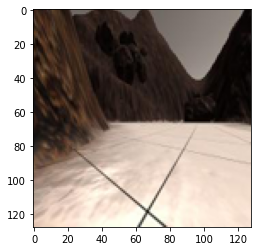

Steerangle_output = -6.60972785949707
Steerangle_target = 0.0
Throttle_output = 0.12254457920789719
Throttle_target = 0.10027739999999999
160


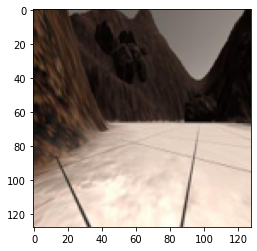

Steerangle_output = -4.1911163330078125
Steerangle_target = 0.0
Throttle_output = 0.05963115766644478
Throttle_target = 0.3005751
161


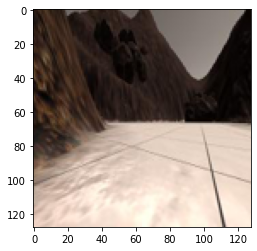

Steerangle_output = -6.925661087036133
Steerangle_target = 0.0
Throttle_output = 0.0355047807097435
Throttle_target = 0.5013057
162


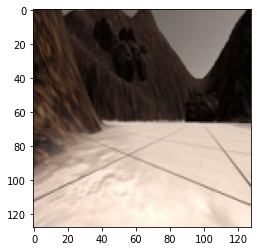

Steerangle_output = -7.552579402923584
Steerangle_target = 0.0
Throttle_output = 0.046295661479234695
Throttle_target = 0.7010904
163


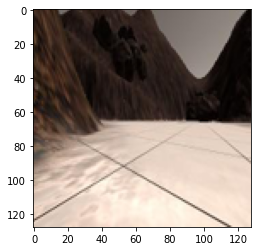

Steerangle_output = -7.564331531524658
Steerangle_target = 0.0
Throttle_output = 0.09319677948951721
Throttle_target = 0.9013824
164


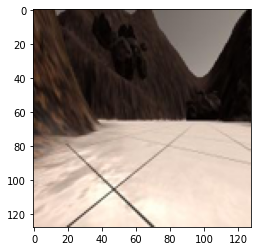

Steerangle_output = -6.588691711425781
Steerangle_target = 0.0
Throttle_output = 0.06554131954908371
Throttle_target = 1.0
165


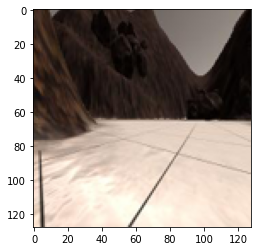

Steerangle_output = -7.999515533447266
Steerangle_target = 0.0
Throttle_output = 0.029680389910936356
Throttle_target = 1.0
166


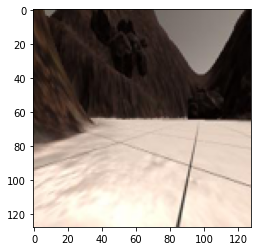

Steerangle_output = -6.878772735595703
Steerangle_target = 0.0
Throttle_output = 0.041357025504112244
Throttle_target = 1.0
167


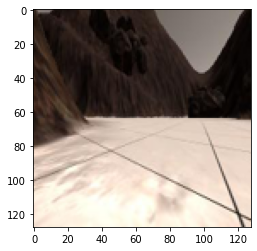

Steerangle_output = -7.626761436462402
Steerangle_target = 0.0
Throttle_output = 0.26823890209198
Throttle_target = 1.0
168


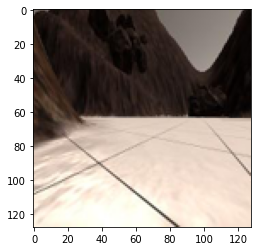

Steerangle_output = -5.976970672607422
Steerangle_target = 0.0
Throttle_output = 0.39616116881370544
Throttle_target = 1.0
169


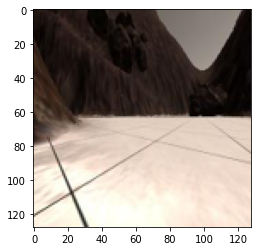

Steerangle_output = -5.530139923095703
Steerangle_target = 0.0
Throttle_output = 0.5329197645187378
Throttle_target = 1.0
170


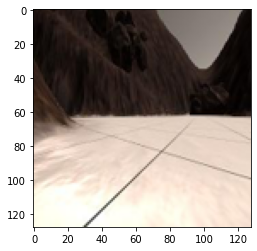

Steerangle_output = -6.870011329650879
Steerangle_target = 0.0
Throttle_output = 0.36151036620140076
Throttle_target = 1.0
171


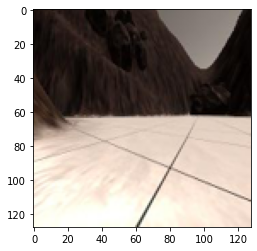

Steerangle_output = -7.952559471130371
Steerangle_target = 0.0
Throttle_output = 0.3512006103992462
Throttle_target = 1.0
172


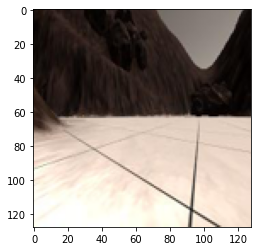

Steerangle_output = -7.997840404510498
Steerangle_target = 0.0
Throttle_output = 0.3245218098163605
Throttle_target = 1.0
173


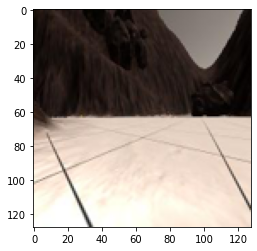

Steerangle_output = -5.736484527587891
Steerangle_target = 0.0
Throttle_output = 0.6251639127731323
Throttle_target = 1.0
174


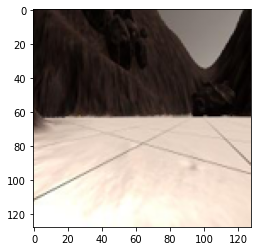

Steerangle_output = -8.336076736450195
Steerangle_target = 0.0
Throttle_output = 0.821236789226532
Throttle_target = 1.0
175


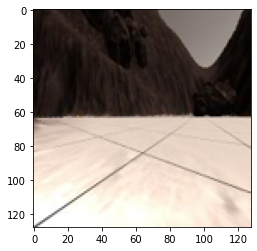

Steerangle_output = -7.337141513824463
Steerangle_target = 0.0
Throttle_output = 0.6772618889808655
Throttle_target = 1.0
176


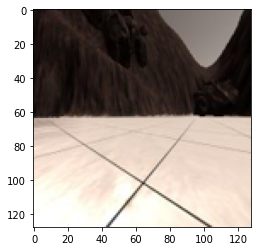

Steerangle_output = -8.907754898071289
Steerangle_target = 0.0
Throttle_output = 0.6434016227722168
Throttle_target = 1.0
177


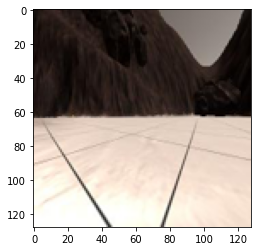

Steerangle_output = -7.986788272857666
Steerangle_target = 0.0
Throttle_output = 0.7036279439926147
Throttle_target = 1.0
178


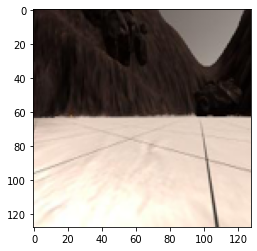

Steerangle_output = -9.963492393493652
Steerangle_target = 0.0
Throttle_output = 0.6768632531166077
Throttle_target = 1.0
179


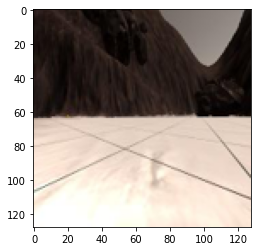

Steerangle_output = -8.349994659423828
Steerangle_target = 0.0
Throttle_output = 0.8976291418075562
Throttle_target = 1.0
180


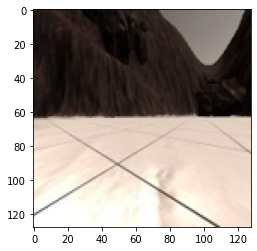

Steerangle_output = -8.620766639709473
Steerangle_target = 0.0
Throttle_output = 0.9529818296432495
Throttle_target = 1.0
181


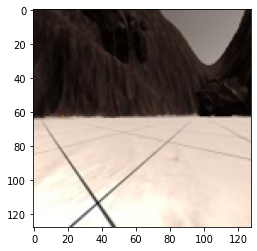

Steerangle_output = -9.665140151977539
Steerangle_target = 0.0
Throttle_output = 0.9149105548858643
Throttle_target = 1.0
182


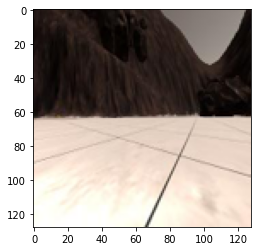

Steerangle_output = -8.73697566986084
Steerangle_target = 0.0
Throttle_output = 0.9138631224632263
Throttle_target = 1.0
183


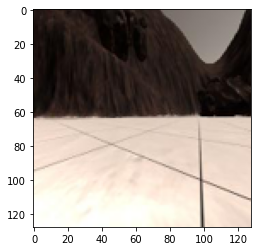

Steerangle_output = -9.185197830200195
Steerangle_target = -2.9954970000000003
Throttle_output = 0.9238483905792236
Throttle_target = 1.0
184


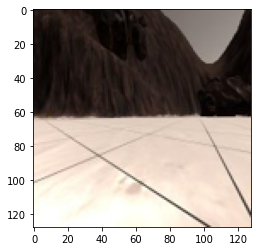

Steerangle_output = -8.495223999023438
Steerangle_target = -6.000624
Throttle_output = 0.9708055257797241
Throttle_target = 1.0
185


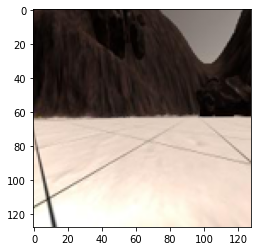

Steerangle_output = -9.757737159729004
Steerangle_target = -8.998596000000001
Throttle_output = 0.9519177675247192
Throttle_target = 1.0
186


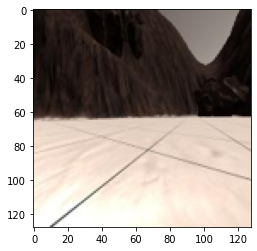

Steerangle_output = -9.868209838867188
Steerangle_target = -12.01155
Throttle_output = 0.890852153301239
Throttle_target = 1.0
187


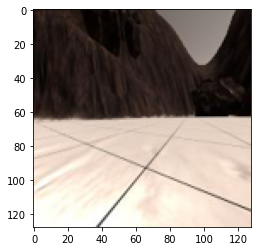

Steerangle_output = -8.260743141174316
Steerangle_target = -11.99596
Throttle_output = 0.941525936126709
Throttle_target = 1.0
188


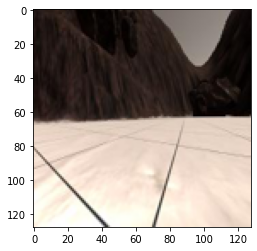

Steerangle_output = -7.132514953613281
Steerangle_target = -9.002464999999999
Throttle_output = 0.6230086088180542
Throttle_target = 1.0
189


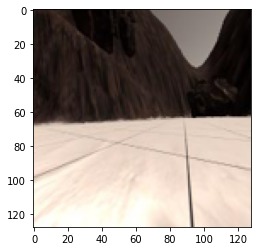

Steerangle_output = -7.601737022399902
Steerangle_target = -6.005137000000001
Throttle_output = 0.5696481466293335
Throttle_target = 1.0
190


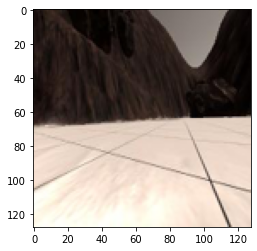

Steerangle_output = -8.125373840332031
Steerangle_target = -2.9998210000000007
Throttle_output = 0.5949927568435669
Throttle_target = 1.0
191


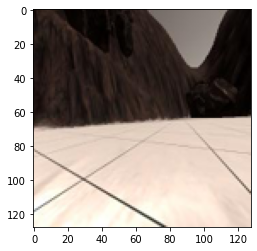

Steerangle_output = -6.862994194030762
Steerangle_target = 0.0
Throttle_output = 0.6569526791572571
Throttle_target = 1.0
192


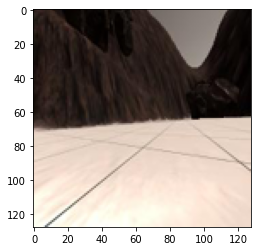

Steerangle_output = -7.543148040771484
Steerangle_target = 0.0
Throttle_output = 0.5929440259933472
Throttle_target = 1.0
193


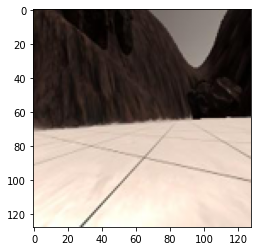

Steerangle_output = -6.784308433532715
Steerangle_target = 0.0
Throttle_output = 0.8243366479873657
Throttle_target = 1.0
194


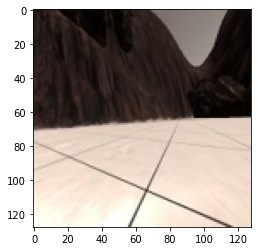

Steerangle_output = -6.957967758178711
Steerangle_target = 0.0
Throttle_output = 0.6328588128089905
Throttle_target = 1.0
195


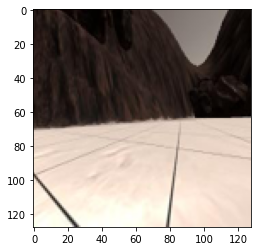

Steerangle_output = -6.376411437988281
Steerangle_target = 0.0
Throttle_output = 0.5806723237037659
Throttle_target = 1.0
196


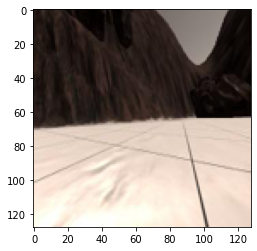

Steerangle_output = -8.090253829956055
Steerangle_target = 0.0
Throttle_output = 0.6540141105651855
Throttle_target = 1.0
197


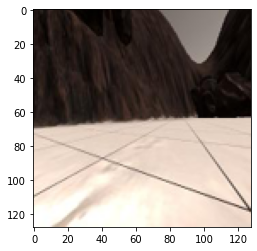

Steerangle_output = -5.899416923522949
Steerangle_target = 0.0
Throttle_output = 0.9481351971626282
Throttle_target = 1.0
198


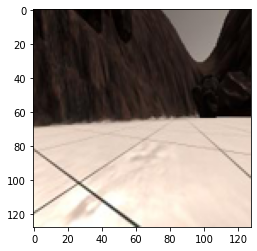

Steerangle_output = -6.167675971984863
Steerangle_target = 0.0
Throttle_output = 0.8158608078956604
Throttle_target = 1.0
199


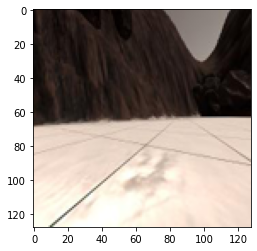

Steerangle_output = -7.2931060791015625
Steerangle_target = 0.0
Throttle_output = 0.8099969625473022
Throttle_target = 1.0
200


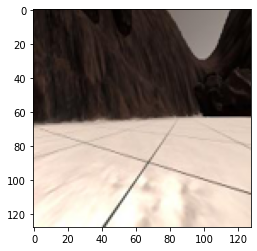

Steerangle_output = -6.422301292419434
Steerangle_target = 0.0
Throttle_output = 0.881822407245636
Throttle_target = 1.0
201


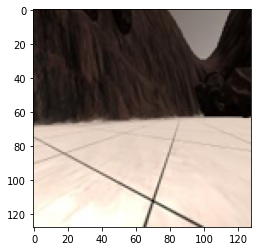

Steerangle_output = -7.426743507385254
Steerangle_target = 0.0
Throttle_output = 0.9398570656776428
Throttle_target = 1.0
202


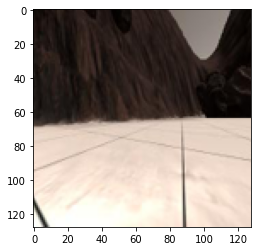

Steerangle_output = -7.2572808265686035
Steerangle_target = 0.0
Throttle_output = 0.8045408725738525
Throttle_target = 1.0
203


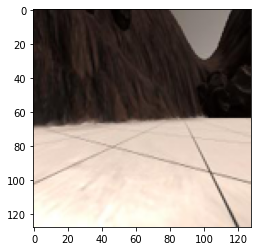

Steerangle_output = -6.503480911254883
Steerangle_target = -1.507968
Throttle_output = 0.8768554925918579
Throttle_target = 1.0
204


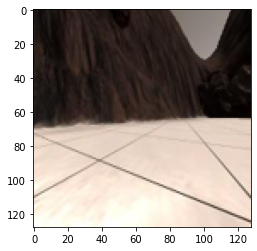

Steerangle_output = -7.081162452697754
Steerangle_target = -4.513031999999999
Throttle_output = 0.9629833698272705
Throttle_target = 1.0
205


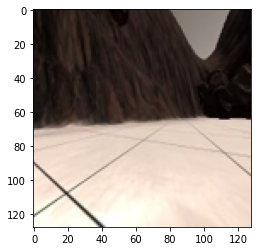

Steerangle_output = -6.131186485290527
Steerangle_target = -7.5065669999999995
Throttle_output = 0.9480265378952026
Throttle_target = 1.0
206


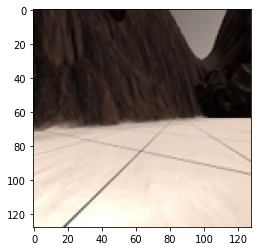

Steerangle_output = -6.877466201782227
Steerangle_target = -10.511989999999999
Throttle_output = 0.9184760451316833
Throttle_target = 1.0
207


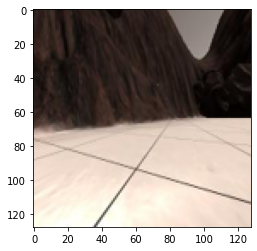

Steerangle_output = -5.170401573181152
Steerangle_target = -13.52289
Throttle_output = 0.8743342757225037
Throttle_target = 0.8998069
208


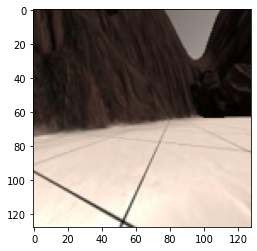

Steerangle_output = -5.856889724731445
Steerangle_target = -15.0
Throttle_output = 0.7886241674423218
Throttle_target = 0.6999409000000001
209


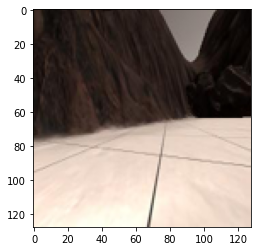

Steerangle_output = -7.494664192199707
Steerangle_target = -15.0
Throttle_output = 0.3463481664657593
Throttle_target = 0.49987780000000004
210


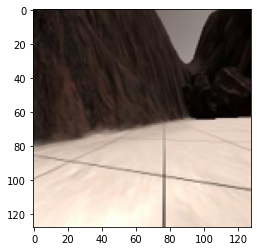

Steerangle_output = -6.612183570861816
Steerangle_target = -15.0
Throttle_output = 0.4778301417827606
Throttle_target = 0.29975440000000003
211


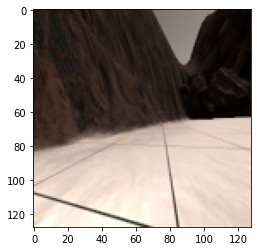

Steerangle_output = -4.3463945388793945
Steerangle_target = -15.0
Throttle_output = 0.36155760288238525
Throttle_target = 0.09988931
212


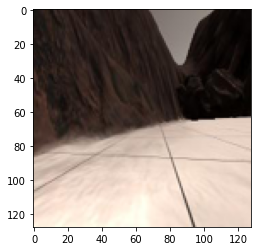

Steerangle_output = -7.304691314697266
Steerangle_target = -15.0
Throttle_output = 0.042683620005846024
Throttle_target = 0.0
213


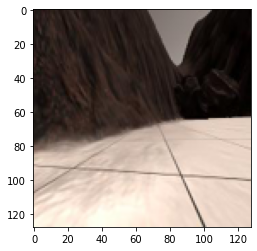

Steerangle_output = -6.880324363708496
Steerangle_target = -15.0
Throttle_output = 0.16881008446216583
Throttle_target = 0.0
214


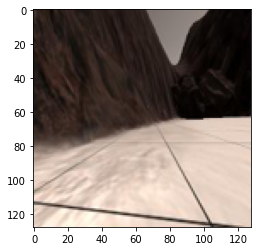

Steerangle_output = -6.2598981857299805
Steerangle_target = -15.0
Throttle_output = 0.18311478197574615
Throttle_target = 0.0
215


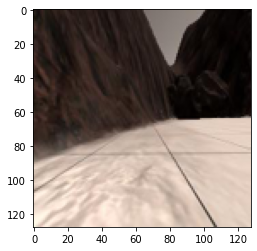

Steerangle_output = -6.463647842407227
Steerangle_target = -15.0
Throttle_output = 0.09941182285547256
Throttle_target = 0.0
216


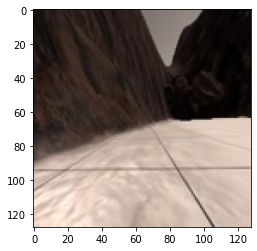

Steerangle_output = -6.0015974044799805
Steerangle_target = -15.0
Throttle_output = 0.07968460768461227
Throttle_target = 0.0
217


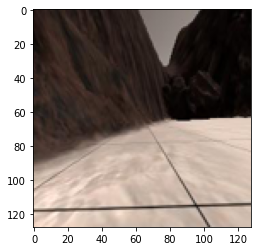

Steerangle_output = -8.432583808898926
Steerangle_target = -15.0
Throttle_output = 0.01800512708723545
Throttle_target = 0.0
218


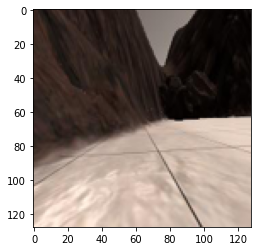

Steerangle_output = -5.4606428146362305
Steerangle_target = -15.0
Throttle_output = 0.09951759874820709
Throttle_target = 0.0
219


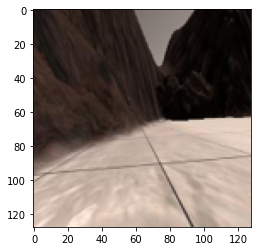

Steerangle_output = -4.951236724853516
Steerangle_target = -15.0
Throttle_output = 0.16701693832874298
Throttle_target = 0.0
220


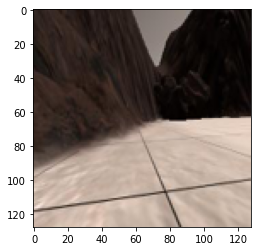

Steerangle_output = -5.932696342468262
Steerangle_target = -15.0
Throttle_output = 0.06389713287353516
Throttle_target = 0.0
221


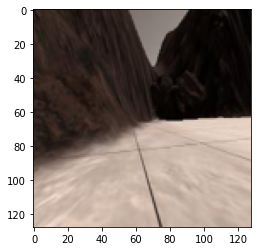

Steerangle_output = -3.2865562438964844
Steerangle_target = -15.0
Throttle_output = 0.22958628833293915
Throttle_target = 0.0
222


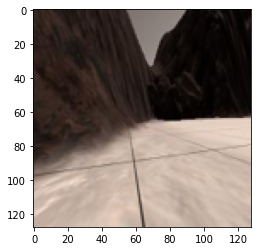

Steerangle_output = -5.679381370544434
Steerangle_target = -15.0
Throttle_output = 0.2545383870601654
Throttle_target = 0.0
223


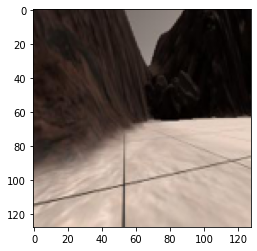

Steerangle_output = -8.433490753173828
Steerangle_target = -15.0
Throttle_output = 0.3144770562648773
Throttle_target = 0.0
224


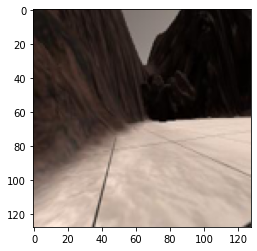

Steerangle_output = -5.892091751098633
Steerangle_target = -15.0
Throttle_output = 0.39481672644615173
Throttle_target = 0.0
225


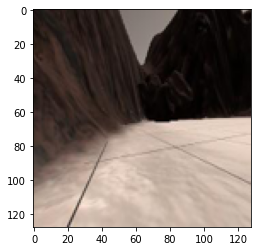

Steerangle_output = -5.123970031738281
Steerangle_target = -15.0
Throttle_output = 0.726162314414978
Throttle_target = 0.0
226


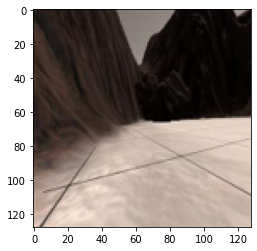

Steerangle_output = -1.2993535995483398
Steerangle_target = -15.0
Throttle_output = 0.7867984771728516
Throttle_target = 0.0
227


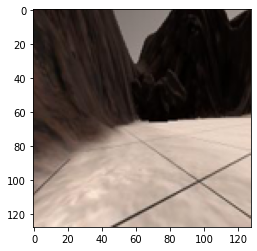

Steerangle_output = -2.129579544067383
Steerangle_target = -15.0
Throttle_output = 0.6302884817123413
Throttle_target = 0.0
228


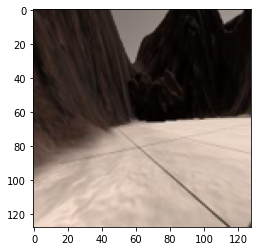

Steerangle_output = -0.37915611267089844
Steerangle_target = -15.0
Throttle_output = 0.7147530913352966
Throttle_target = 0.0
229


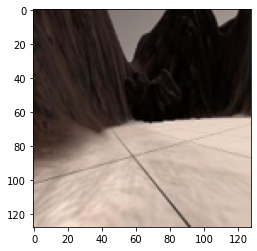

Steerangle_output = -0.28645992279052734
Steerangle_target = -15.0
Throttle_output = 0.8148946166038513
Throttle_target = 0.0
230


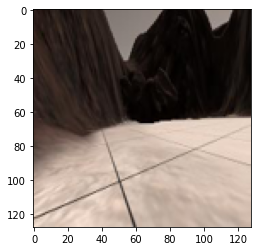

Steerangle_output = -0.25942420959472656
Steerangle_target = -15.0
Throttle_output = 0.8539096117019653
Throttle_target = 0.0
231


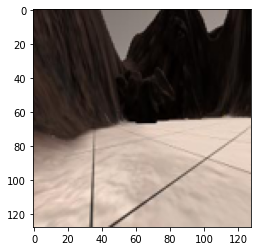

Steerangle_output = 0.06159210205078125
Steerangle_target = -15.0
Throttle_output = 0.9338807463645935
Throttle_target = 0.0
232


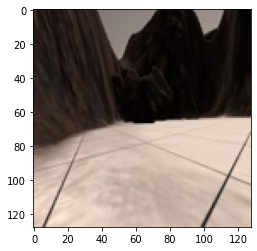

Steerangle_output = -1.8832521438598633
Steerangle_target = -15.0
Throttle_output = 0.9067949652671814
Throttle_target = 0.0
233


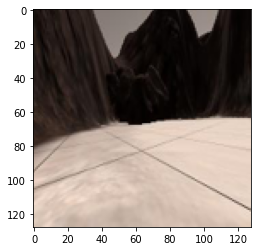

Steerangle_output = -0.5662546157836914
Steerangle_target = -15.0
Throttle_output = 0.7856978178024292
Throttle_target = 0.0
234


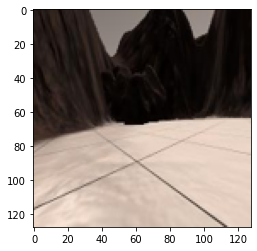

Steerangle_output = -0.6804208755493164
Steerangle_target = -15.0
Throttle_output = 0.8407341241836548
Throttle_target = 0.0
235


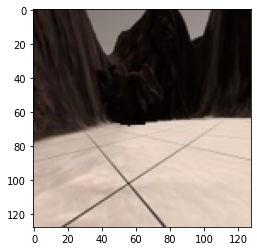

Steerangle_output = 0.3584756851196289
Steerangle_target = -15.0
Throttle_output = 0.890258252620697
Throttle_target = 0.0
236


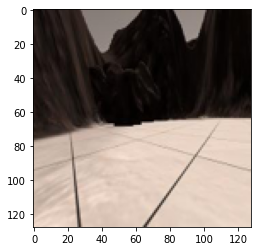

Steerangle_output = 0.40674400329589844
Steerangle_target = -15.0
Throttle_output = 0.9198597073554993
Throttle_target = 0.0
237


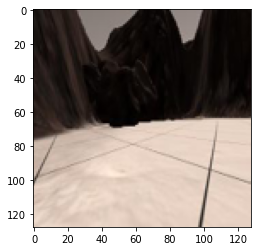

Steerangle_output = -2.3685054779052734
Steerangle_target = -15.0
Throttle_output = 0.9253693222999573
Throttle_target = 0.0
238


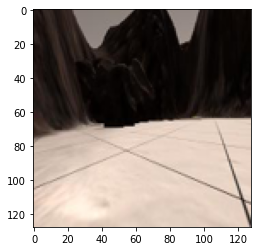

Steerangle_output = 1.6207008361816406
Steerangle_target = -15.0
Throttle_output = 0.9682103991508484
Throttle_target = 0.0
239


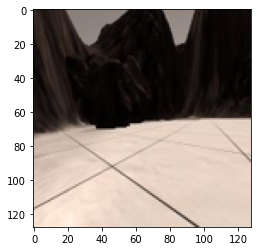

Steerangle_output = 0.4808073043823242
Steerangle_target = -15.0
Throttle_output = 0.9905794262886047
Throttle_target = 0.0
240


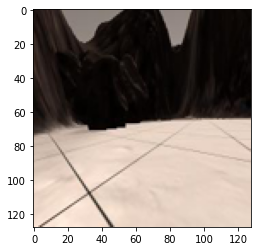

Steerangle_output = 0.06617927551269531
Steerangle_target = -15.0
Throttle_output = 0.9880192875862122
Throttle_target = 0.0
241


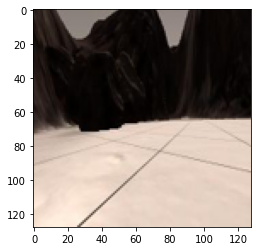

Steerangle_output = 0.9066638946533203
Steerangle_target = -13.49499
Throttle_output = 0.9918712377548218
Throttle_target = 0.0
242


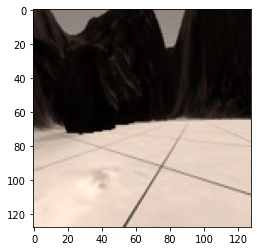

Steerangle_output = 1.3357391357421875
Steerangle_target = -10.49593
Throttle_output = 0.982302188873291
Throttle_target = 0.0
243


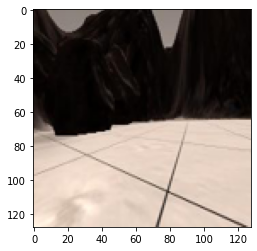

Steerangle_output = 0.18068981170654297
Steerangle_target = -7.497924
Throttle_output = 0.9830080270767212
Throttle_target = 0.0
244


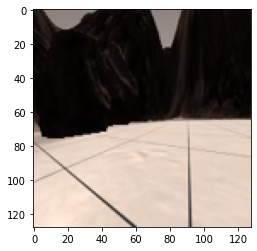

Steerangle_output = 0.5737152099609375
Steerangle_target = -4.4982240000000004
Throttle_output = 0.9084837436676025
Throttle_target = 0.0
245


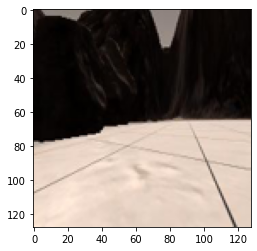

Steerangle_output = -2.5092153549194336
Steerangle_target = -1.4954330000000002
Throttle_output = 0.8091140985488892
Throttle_target = 0.0
246


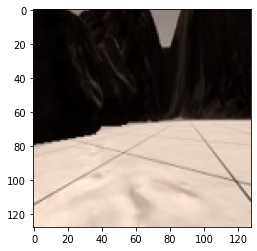

Steerangle_output = -1.2820091247558594
Steerangle_target = 0.0
Throttle_output = 0.895961582660675
Throttle_target = 0.0
247


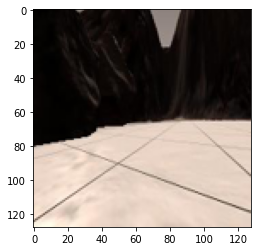

Steerangle_output = -2.147467613220215
Steerangle_target = 0.0
Throttle_output = 0.862034261226654
Throttle_target = 0.0
248


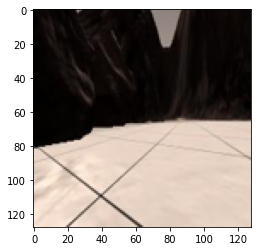

Steerangle_output = -1.7167472839355469
Steerangle_target = 0.0
Throttle_output = 0.8408576846122742
Throttle_target = 0.0
249


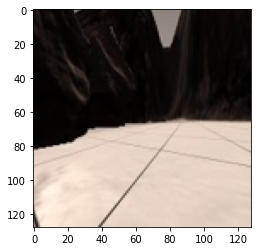

Steerangle_output = 0.33306407928466797
Steerangle_target = 0.0
Throttle_output = 0.7391521334648132
Throttle_target = 0.0
250


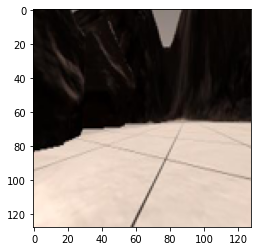

Steerangle_output = 0.7712907791137695
Steerangle_target = 0.0
Throttle_output = 0.8123477697372437
Throttle_target = 0.0
251


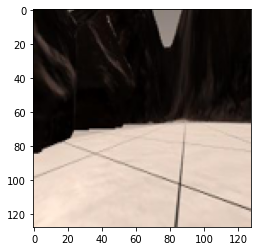

Steerangle_output = -0.4965848922729492
Steerangle_target = 0.0
Throttle_output = 0.8346890211105347
Throttle_target = 0.0
252


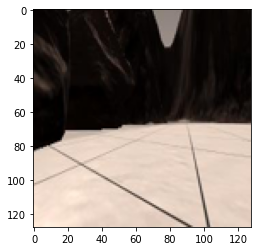

Steerangle_output = -1.8262453079223633
Steerangle_target = 0.0
Throttle_output = 0.9400193095207214
Throttle_target = 0.0
253


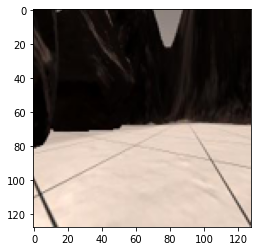

Steerangle_output = -0.7872705459594727
Steerangle_target = 0.0
Throttle_output = 0.9631397128105164
Throttle_target = 0.0
254


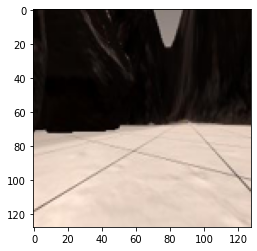

Steerangle_output = -0.9613504409790039
Steerangle_target = -1.4969289999999997
Throttle_output = 0.957310140132904
Throttle_target = 0.0
255


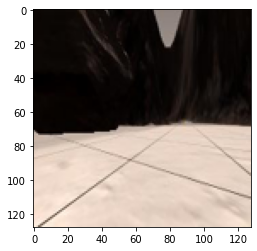

Steerangle_output = -1.437056541442871
Steerangle_target = -4.499361
Throttle_output = 0.8778744339942932
Throttle_target = 0.0
256


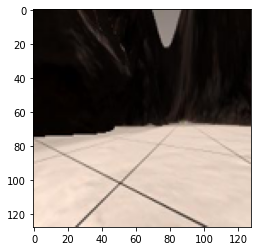

Steerangle_output = -1.2441892623901367
Steerangle_target = -7.499646
Throttle_output = 0.8546853065490723
Throttle_target = 0.0
257


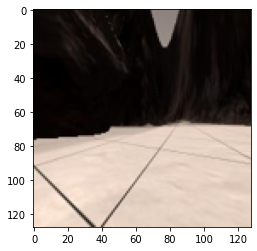

Steerangle_output = -2.067429542541504
Steerangle_target = -10.505189999999999
Throttle_output = 0.8854402899742126
Throttle_target = 0.0
258


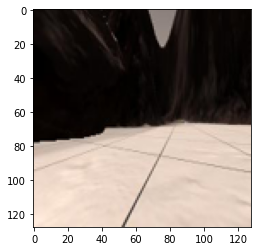

Steerangle_output = -2.168649673461914
Steerangle_target = -13.50944
Throttle_output = 0.8533417582511902
Throttle_target = 0.0
259


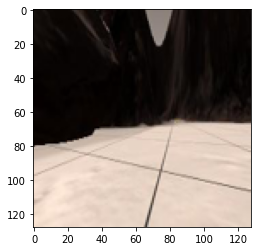

Steerangle_output = -3.1577987670898438
Steerangle_target = -15.0
Throttle_output = 0.8596118092536926
Throttle_target = 0.0
260


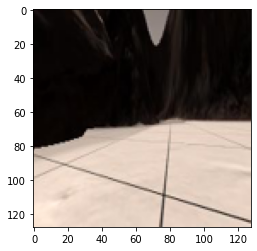

Steerangle_output = -4.2689666748046875
Steerangle_target = -15.0
Throttle_output = 0.8299884796142578
Throttle_target = 0.0
261


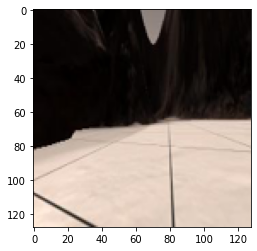

Steerangle_output = -3.6361312866210938
Steerangle_target = -15.0
Throttle_output = 0.8679181933403015
Throttle_target = 0.0
262


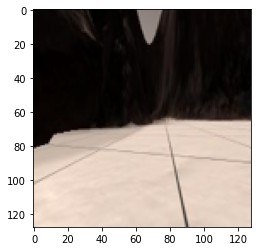

Steerangle_output = -2.8042211532592773
Steerangle_target = -15.0
Throttle_output = 0.9445164799690247
Throttle_target = 0.0
263


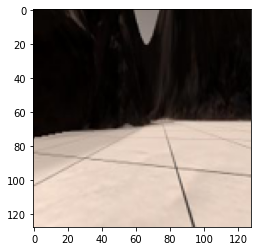

Steerangle_output = -2.738157272338867
Steerangle_target = -15.0
Throttle_output = 0.888403058052063
Throttle_target = 0.0
264


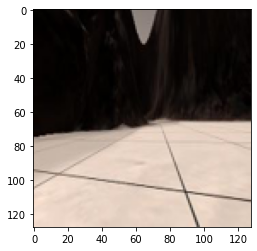

Steerangle_output = -1.7979097366333008
Steerangle_target = -15.0
Throttle_output = 0.8701027035713196
Throttle_target = 0.0
265


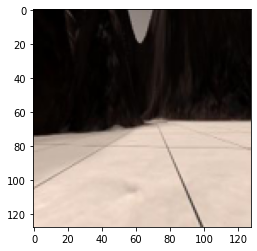

Steerangle_output = -3.1446399688720703
Steerangle_target = -15.0
Throttle_output = 0.8770986795425415
Throttle_target = 0.0
266


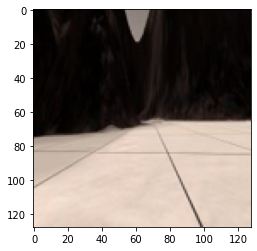

Steerangle_output = -1.7741670608520508
Steerangle_target = -15.0
Throttle_output = 0.9014239311218262
Throttle_target = 0.0
267


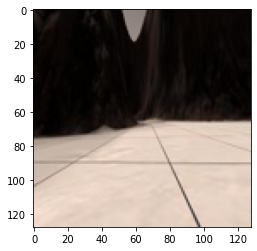

Steerangle_output = -1.1185407638549805
Steerangle_target = -15.0
Throttle_output = 0.9154051542282104
Throttle_target = 0.0
268


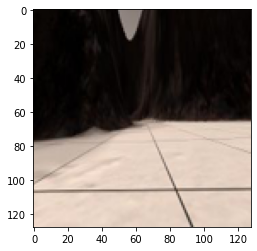

Steerangle_output = -3.4004087448120117
Steerangle_target = -15.0
Throttle_output = 0.6467368602752686
Throttle_target = 0.0
269


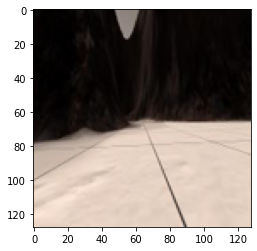

Steerangle_output = -0.5671005249023438
Steerangle_target = -15.0
Throttle_output = 0.7838348150253296
Throttle_target = 0.0
270


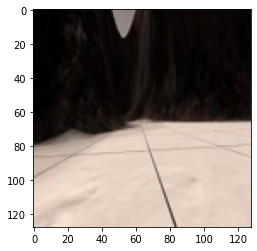

Steerangle_output = 1.7761077880859375
Steerangle_target = -15.0
Throttle_output = 0.8016297221183777
Throttle_target = 0.0
271


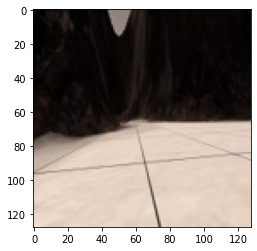

Steerangle_output = 2.6421966552734375
Steerangle_target = -15.0
Throttle_output = 0.8463068008422852
Throttle_target = 0.0
272


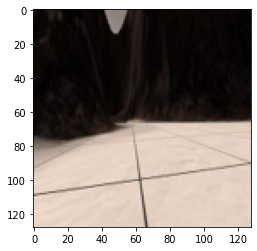

Steerangle_output = 0.3575096130371094
Steerangle_target = -15.0
Throttle_output = 0.7438550591468811
Throttle_target = 0.0
273


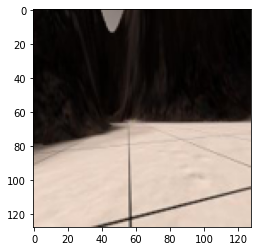

Steerangle_output = -3.188778877258301
Steerangle_target = -15.0
Throttle_output = 0.6996635794639587
Throttle_target = 0.0
274


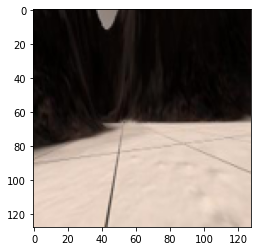

Steerangle_output = -0.06385135650634766
Steerangle_target = -15.0
Throttle_output = 0.8582531809806824
Throttle_target = 0.0
275


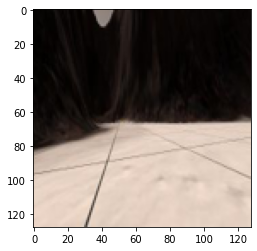

Steerangle_output = -0.6689910888671875
Steerangle_target = -15.0
Throttle_output = 0.8859277367591858
Throttle_target = 0.0
276


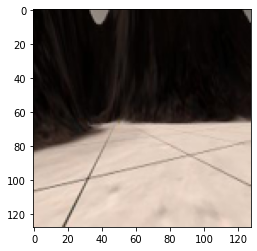

Steerangle_output = -0.4320049285888672
Steerangle_target = -15.0
Throttle_output = 0.9044394493103027
Throttle_target = 0.0
277


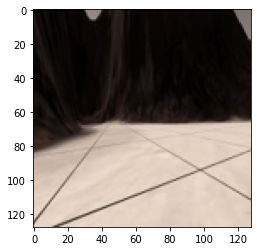

Steerangle_output = -6.229886054992676
Steerangle_target = -15.0
Throttle_output = 0.8760120272636414
Throttle_target = 0.0
278


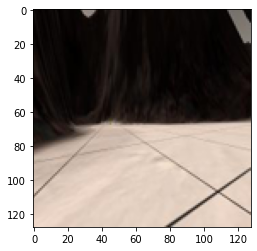

Steerangle_output = -8.546765327453613
Steerangle_target = -15.0
Throttle_output = 0.541810929775238
Throttle_target = 0.0
279


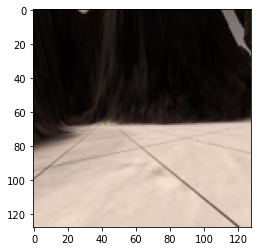

Steerangle_output = -5.527371406555176
Steerangle_target = -15.0
Throttle_output = 0.7640414237976074
Throttle_target = 0.0
280


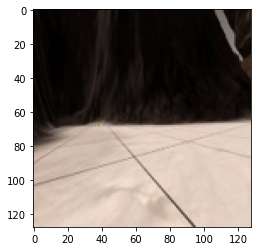

Steerangle_output = -3.405038833618164
Steerangle_target = -15.0
Throttle_output = 0.7681818008422852
Throttle_target = 0.0
281


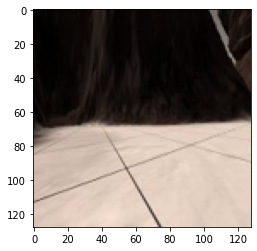

Steerangle_output = -4.477095603942871
Steerangle_target = -15.0
Throttle_output = 0.7194076776504517
Throttle_target = 0.0
282


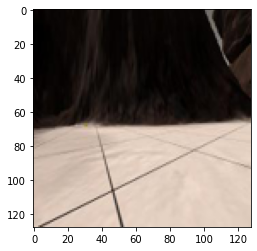

Steerangle_output = -5.9223175048828125
Steerangle_target = -15.0
Throttle_output = 0.6054495573043823
Throttle_target = 0.0
283


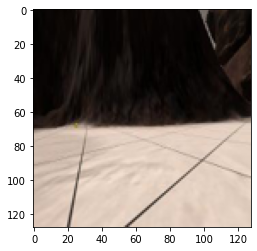

Steerangle_output = -6.572588920593262
Steerangle_target = -15.0
Throttle_output = 0.7675942778587341
Throttle_target = 0.0
284


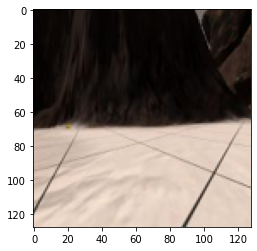

Steerangle_output = -6.1764068603515625
Steerangle_target = -15.0
Throttle_output = 0.7937755584716797
Throttle_target = 0.0
285


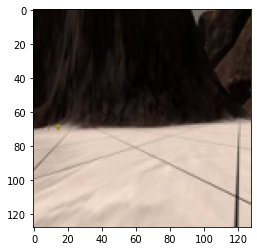

Steerangle_output = -6.805253982543945
Steerangle_target = -15.0
Throttle_output = 0.6691486239433289
Throttle_target = 0.0
286


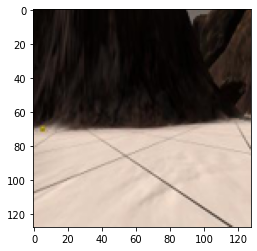

Steerangle_output = -7.345958709716797
Steerangle_target = -15.0
Throttle_output = 0.8265032768249512
Throttle_target = 0.0
287


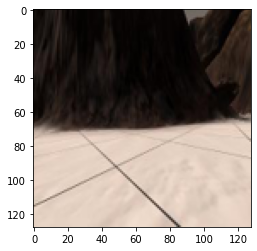

Steerangle_output = -6.941678047180176
Steerangle_target = -11.99269
Throttle_output = 0.8381280303001404
Throttle_target = 0.0
288


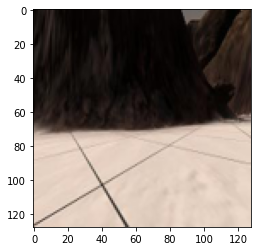

Steerangle_output = -8.57264518737793
Steerangle_target = -9.000982
Throttle_output = 0.8418888449668884
Throttle_target = 0.0
289


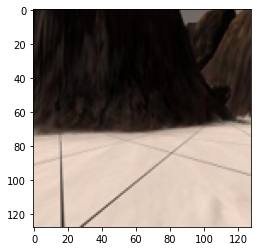

Steerangle_output = -10.196121215820312
Steerangle_target = -5.995675
Throttle_output = 0.7719519138336182
Throttle_target = 0.0
290


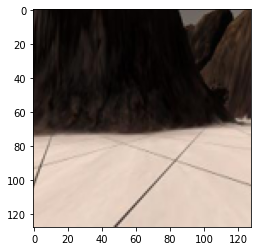

Steerangle_output = -7.842899799346924
Steerangle_target = -2.986668999999999
Throttle_output = 0.850517749786377
Throttle_target = 0.0
291


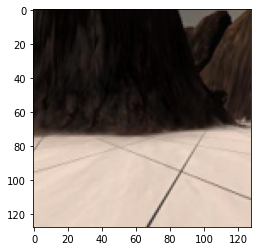

Steerangle_output = -6.537863731384277
Steerangle_target = 0.0
Throttle_output = 0.5443411469459534
Throttle_target = 0.0
292


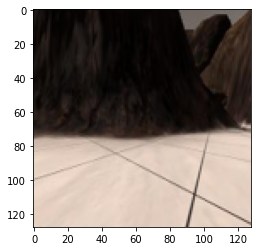

Steerangle_output = -8.949966430664062
Steerangle_target = 0.0
Throttle_output = 0.34413662552833557
Throttle_target = 0.0
293


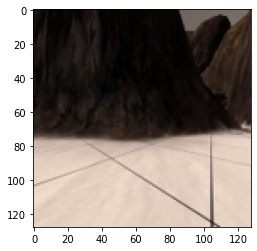

Steerangle_output = -8.103964805603027
Steerangle_target = 0.0
Throttle_output = 0.5161919593811035
Throttle_target = 0.0
294


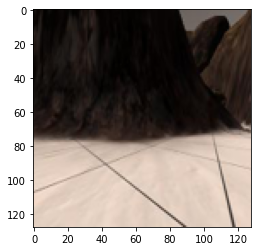

Steerangle_output = -9.219937324523926
Steerangle_target = 0.0
Throttle_output = 0.4360809326171875
Throttle_target = 0.0
295


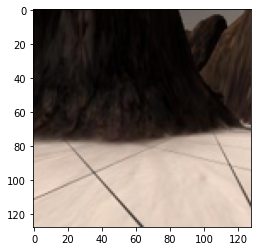

Steerangle_output = -9.540599822998047
Steerangle_target = 0.0
Throttle_output = 0.18947848677635193
Throttle_target = 0.0
296


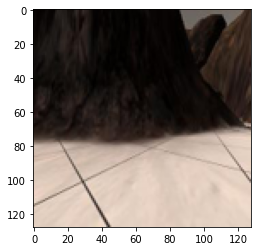

Steerangle_output = -9.646011352539062
Steerangle_target = 0.0
Throttle_output = 0.13059601187705994
Throttle_target = 0.0
297


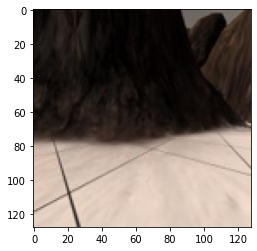

Steerangle_output = -8.6787109375
Steerangle_target = 0.0
Throttle_output = 0.12845221161842346
Throttle_target = 0.0
298


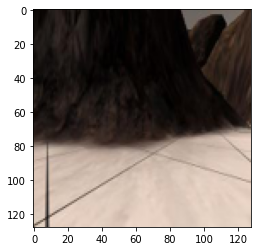

Steerangle_output = -9.25113296508789
Steerangle_target = 0.0
Throttle_output = 0.03877602517604828
Throttle_target = 0.0
299


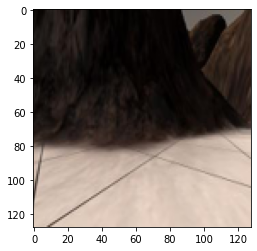

Steerangle_output = -9.473428726196289
Steerangle_target = 0.0
Throttle_output = 0.11665480583906174
Throttle_target = 0.0
300


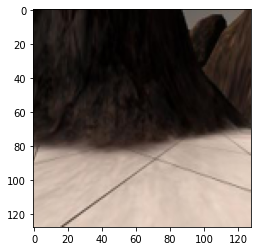

Steerangle_output = -9.311704635620117
Steerangle_target = 0.0
Throttle_output = 0.13345494866371155
Throttle_target = 0.0
301


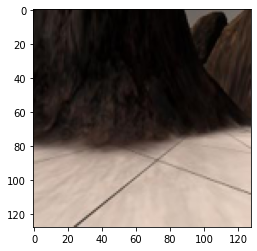

Steerangle_output = -10.750946998596191
Steerangle_target = 0.0
Throttle_output = 0.09399476647377014
Throttle_target = 0.0
302


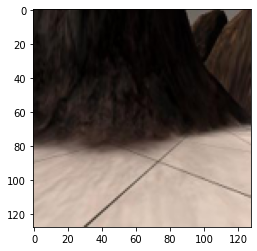

Steerangle_output = -9.766357421875
Steerangle_target = -3.005167
Throttle_output = 0.08260571211576462
Throttle_target = 0.0
303


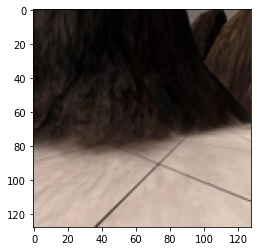

Steerangle_output = -9.745345115661621
Steerangle_target = -6.005205
Throttle_output = 0.2064315527677536
Throttle_target = 0.0
304


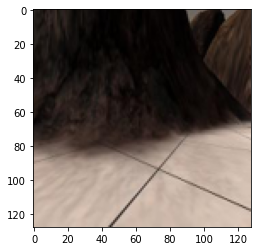

Steerangle_output = -7.966668128967285
Steerangle_target = -9.01012
Throttle_output = 0.06767213344573975
Throttle_target = 0.0
305


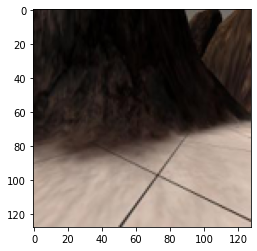

Steerangle_output = -8.531301498413086
Steerangle_target = -12.02327
Throttle_output = 0.06189661845564842
Throttle_target = 0.0
306


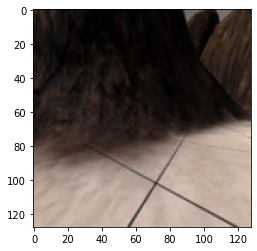

Steerangle_output = -8.17657470703125
Steerangle_target = -15.0
Throttle_output = 0.09618515521287918
Throttle_target = 0.0
307


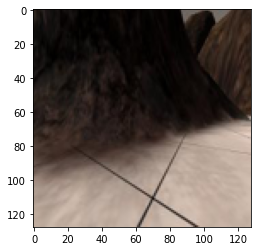

Steerangle_output = -8.012527465820312
Steerangle_target = -15.0
Throttle_output = 0.13549953699111938
Throttle_target = 0.0
308


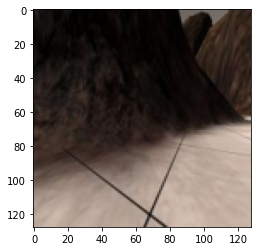

Steerangle_output = -8.852067947387695
Steerangle_target = -15.0
Throttle_output = 0.21857956051826477
Throttle_target = 0.0
309


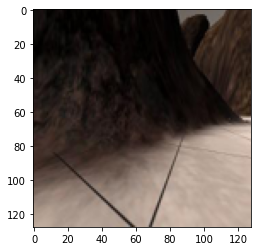

Steerangle_output = -9.862592697143555
Steerangle_target = -15.0
Throttle_output = 0.3207872807979584
Throttle_target = 0.0
310


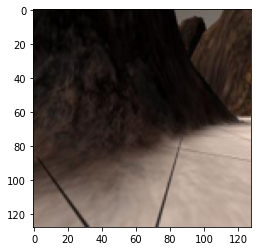

Steerangle_output = -10.112869262695312
Steerangle_target = -15.0
Throttle_output = 0.14224375784397125
Throttle_target = 0.0
311


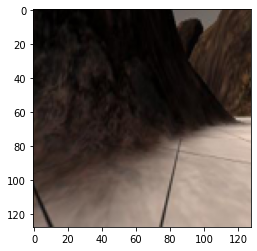

Steerangle_output = -10.755473136901855
Steerangle_target = -15.0
Throttle_output = 0.06082077696919441
Throttle_target = 0.0
312


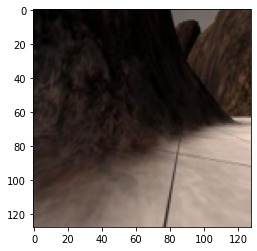

Steerangle_output = -9.935138702392578
Steerangle_target = -15.0
Throttle_output = 0.06379984319210052
Throttle_target = 0.0
313


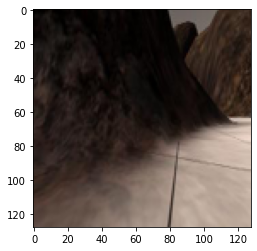

Steerangle_output = -9.624176979064941
Steerangle_target = -15.0
Throttle_output = 0.05144518241286278
Throttle_target = 0.0
314


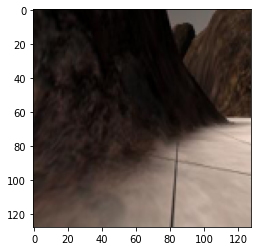

Steerangle_output = -9.690851211547852
Steerangle_target = -15.0
Throttle_output = 0.04843771457672119
Throttle_target = 0.0
315


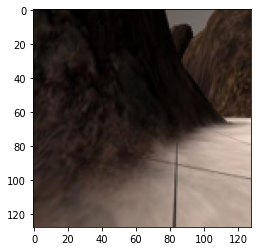

Steerangle_output = -10.407140731811523
Steerangle_target = -15.0
Throttle_output = 0.06738869100809097
Throttle_target = 0.0
316


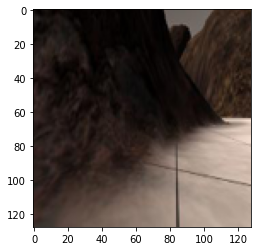

Steerangle_output = -10.462200164794922
Steerangle_target = -12.01722
Throttle_output = 0.10029260814189911
Throttle_target = 0.0
317


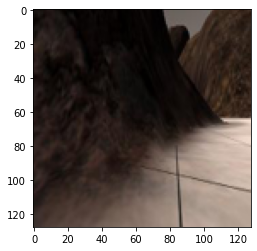

Steerangle_output = -9.248824119567871
Steerangle_target = -8.987955
Throttle_output = 0.09569787979125977
Throttle_target = 0.0
318


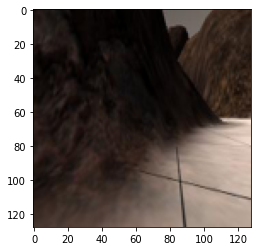

Steerangle_output = -9.826147079467773
Steerangle_target = -5.995231
Throttle_output = 0.09889321774244308
Throttle_target = 0.0
319


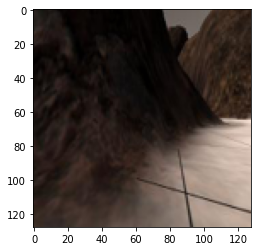

Steerangle_output = -8.827165603637695
Steerangle_target = -2.983943
Throttle_output = 0.08198530972003937
Throttle_target = 0.0
320


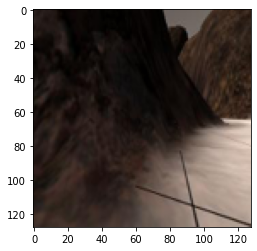

Steerangle_output = -9.255687713623047
Steerangle_target = 0.0
Throttle_output = 0.0738515630364418
Throttle_target = 0.0
321


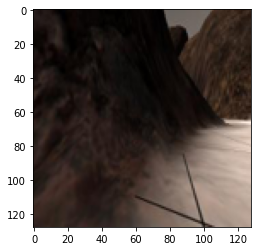

Steerangle_output = -9.96137523651123
Steerangle_target = 0.0
Throttle_output = 0.10738193243741989
Throttle_target = 0.0
322


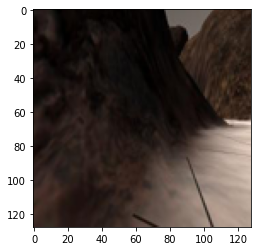

Steerangle_output = -9.689464569091797
Steerangle_target = 0.0
Throttle_output = 0.07113678753376007
Throttle_target = 0.0
323


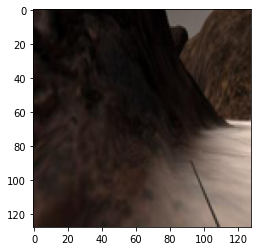

Steerangle_output = -8.353933334350586
Steerangle_target = 0.0
Throttle_output = 0.12299760431051254
Throttle_target = 0.0
324


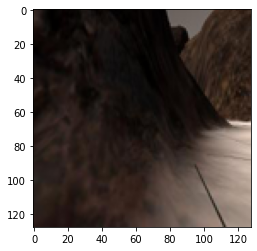

Steerangle_output = -9.33188247680664
Steerangle_target = 0.0
Throttle_output = 0.07484129071235657
Throttle_target = 0.0
325


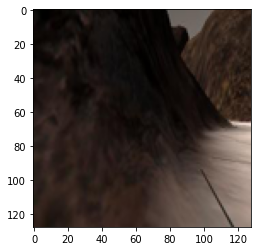

Steerangle_output = -8.576303482055664
Steerangle_target = 0.0
Throttle_output = 0.06778782606124878
Throttle_target = 0.0
326


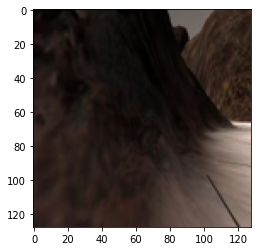

Steerangle_output = -8.86785888671875
Steerangle_target = 0.0
Throttle_output = 0.08775739371776581
Throttle_target = 0.0
327


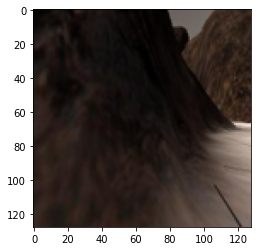

Steerangle_output = -8.987730979919434
Steerangle_target = 0.0
Throttle_output = 0.0499315969645977
Throttle_target = 0.0
328


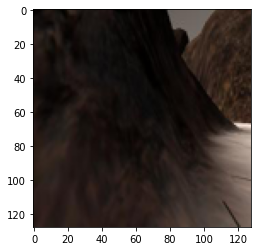

Steerangle_output = -8.835195541381836
Steerangle_target = 0.0
Throttle_output = 0.04075222462415695
Throttle_target = 0.0
329


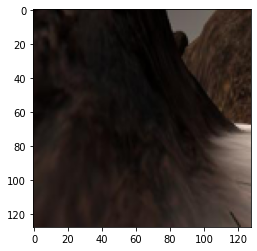

Steerangle_output = -8.02935791015625
Steerangle_target = 0.0
Throttle_output = 0.05427270382642746
Throttle_target = 0.0
330


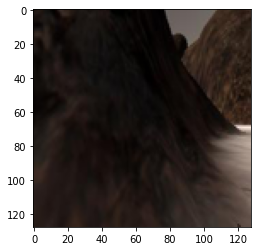

Steerangle_output = -8.012676239013672
Steerangle_target = 0.0
Throttle_output = 0.07050278037786484
Throttle_target = 0.0
331


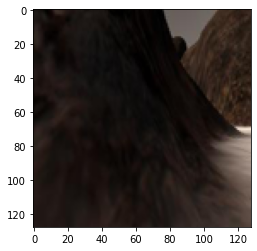

Steerangle_output = -7.800201892852783
Steerangle_target = 0.0
Throttle_output = 0.07238251715898514
Throttle_target = 0.0
332


In [32]:
# test-the-model
model.eval()  # it-disables-dropout
i=0
with torch.no_grad():
  for images, labels in test_loader:
    images = images.to(device)
    labels = labels.to(device)
    outputs = model(images)
    images = np.asarray(images[0,:,:,:].cpu().permute(1, 2, 0))
    plt.imshow(images)
    plt.show()
    print("Steerangle_output =", float(outputs[0][0]*30 -15))
    print("Steerangle_target =", float(labels[0][0]*30 -15 ))
    print("Throttle_output =", float(outputs[0][1]))
    print("Throttle_target =", float(labels[0][1]))
    i+=1
    print(i)